<a href="https://colab.research.google.com/github/dishapalan02/AI-Enabled-IT-Service-Ticketing-tool/blob/main/Capstone_Project_master.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***AI Enabled IT Ticketing Service Tool*** 

# 1. PROBLEM STATEMENT 

In any of the IT industry, incident management plays an important role in delivering quality and timely support to its customers across the globe.

The incidents are generally created by various stakeholders like end users, vendors, IT users, etc. They might not have right information as to which team the ticket should go to. Hence, to imporve and retain customer satisfaction, it is very important that the ticket is assigned to the right group of people for faster and approproiate resolution. In many Organizations this is still a manual process. There are few problems with the manual process:
1. Manual assignment of incidents is time consuming
2. It requires human efforts
3. There may be mistakes due to human errors and resource consumption is carried out ineffectively because of the misaddressing
4. Manual assignment increases the response and resolution times which result in user satisfaction deterioration / poor customer service

L1 / L2 needs to spend time to review Standard Operating Procedures (SOPs) before assigning to Functional teams (Minimum 25–30% of incidents needs to be reviewed for SOPs before ticket assignment).  

15 mins are being spent for SOP review for each incident. Minimum of 1 FTE effort needed only for incident assignment to L3 teams.  

During the process of incident assignments by L1 / L2 teams to functional groups, there were multiple instances of incidents getting assigned to wrong functional groups.  

Around 25% of Incidents are wrongly assigned to functional teams. Additional effort needed for Functional teams to re-assign to right functional groups 

During this process, some of the incidents are in queue and not addressed timely resulting in poor customer service and loss of business.




# 2. OBJECTIVE

We are building an AI solution which will enable organizations to classify incidents to the right functional group by implementing the best suited machine learning model and leading to customer satisfaction. 

Guided by AI, organizations can reduce the resolution time and focus on more productive tasks. This will overcome and save time with below losses:

1. Time latency due to review of SOPs before assigning to right functional group 
2. Incorrect assignments to functional groups
3. #ToDo ( Include figures for losses and revenue ) --> to be checked by Gloria 

# 3. SOLUTION

ToDo ( Add the different approches taken )

# 3.1 INSTALL THE REQUIRED LIBRARIES

In [1]:
# Sweetviz is an open-source Python library that generates beautiful, high-density visualizations 
# to kickstart EDA (Exploratory Data Analysis) with just two lines of code. 
# Output is a fully self-contained HTML application.

!pip install sweetviz

     |████████████████████████████████| 15.1MB 197kB/s 
     |████████████████████████████████| 81kB 10.0MB/s 
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully uninstalled tqdm-4.41.1


In [2]:
# Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code.
# It generates a report with all the information easily available
!pip install pandas-profiling==2.7.1

In [2]:
#Visualization library to generate graphs
!pip install plotly==4.4.1

In [3]:
#We need cufflinks to link plotly to pandas dataframe and add the iplot method
!pip install plotly cufflinks

In [4]:
#Fixes Text For You :- Library to detect and fix Mojibakes.It fixes Unicode that’s broken. The goal of ftfy is to take in bad Unicode and output good Unicode.
!pip install ftfy

     |████████████████████████████████| 71kB 4.2MB/s 
  Created wheel for ftfy: filename=ftfy-6.0.3-cp37-none-any.whl size=41935 sha256=d1ec20f07e6be689e7cc18bb5ff509f84af4baca12ae79f365c4f8bccf13c541
  Stored in directory: /root/.cache/pip/wheels/99/2c/e6/109c8a28fef7a443f67ba58df21fe1d0067ac3322e75e6b0b7
Successfully built ftfy


In [5]:
#Detects language of a given text
!pip install langdetect

     |████████████████████████████████| 983kB 6.8MB/s 
  Created wheel for langdetect: filename=langdetect-1.0.9-cp37-none-any.whl size=993242 sha256=45f5e0fd314c21d69dde280b0d694441f374e1b3aa0f4cd000ae75e07acb0609
  Stored in directory: /root/.cache/pip/wheels/7e/18/13/038c34057808931c7ddc6c92d3aa015cf1a498df5a70268996
Successfully built langdetect


In [6]:
!pip install translate-api

     |████████████████████████████████| 6.3MB 7.2MB/s 
     |████████████████████████████████| 61kB 6.8MB/s 
  Created wheel for PyExecJS: filename=PyExecJS-1.5.1-cp37-none-any.whl size=14597 sha256=5481918b5726671311814f455d69766c8fd289bf3699a9e98669dbab0a05f985
  Stored in directory: /root/.cache/pip/wheels/43/25/28/52dd7a6c691b1551e3d4482f3f16ef630cc9f59cae99cd33ba
Successfully built PyExecJS
  Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


# 3.2 IMPORTING NECESSARY LIBRARIES

In [8]:
# Basic libraries
import pandas as pd                         # Needed for data structures
import numpy as np                          # Needed for numerical calculation

# Data Visualization
import matplotlib.pyplot as plt             # Needed for graphs and charts during data analysis
import seaborn as sns                       # Needed for graphs and charts during data analysis
from wordcloud import WordCloud, STOPWORDS  # Needed to display word clouds
import plotly.offline as plty
from plotly.offline import iplot
import cufflinks as cf
cf.go_offline()
import plotly.io as pio
pio.renderers.default = 'colab'
import plotly.express as px

# EDA Reporting
import sweetviz as sv                       # Needed for EDA and generating report
from pandas_profiling import ProfileReport  # Needed for EDA and generating report

# Show graphs and plots inline
%matplotlib inline

# Text Processing 
import ftfy
from langdetect import detect
import re

#NLP toolkits
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stopwords = set(stopwords.words('english'))
nltk.download('wordnet')
from textblob import Word

#Translations
import requests
import json
import pickle
import translators as ts

#Evaluation Metrics
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
from sklearn.metrics import classification_report

# Traditional Modeling
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer,TfidfTransformer
from sklearn.model_selection import GridSearchCV
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
from sklearn.pipeline import Pipeline
from sklearn.multiclass import OneVsRestClassifier
from sklearn.naive_bayes import MultinomialNB

#Sequential Modeling


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# 3.3 IMPORT THE DATASET

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Fetch the data from input data stored in Goolge drive
incidents_data = pd.read_excel('/content/drive/MyDrive/Capstone/input_data.xlsx')

In [10]:
# Check the first 5 rows of dataset
incidents_data.head()

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [12]:
#Check the last 5 rows of the dataset
incidents_data.tail()

,Short description,Description,Caller,Assignment group
8495,emails not coming in from zz mail,\r\n\r\nreceived from: avglmrts.vhqmtiua@gmail...,avglmrts vhqmtiua,GRP_29
8496,telephony_software issue,telephony_software issue,rbozivdq gmlhrtvp,GRP_0
8497,vip2: windows password reset for tifpdchb pedx...,vip2: windows password reset for tifpdchb pedx...,oybwdsgx oxyhwrfz,GRP_0
8498,machine nÃ£o estÃ¡ funcionando,i am unable to access the machine utilities to...,ufawcgob aowhxjky,GRP_62
8499,an mehreren pc`s lassen sich verschiedene prgr...,an mehreren pc`s lassen sich verschiedene prgr...,kqvbrspl jyzoklfx,GRP_49


# 3.4 EDA

## 3.4.1 Visualizing and analysing data

### 3.4.1.1 Report visualization using SweetViz

                                             |          | [  0%]   00:00 -> (? left)

Report Incidents_sweetviz_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



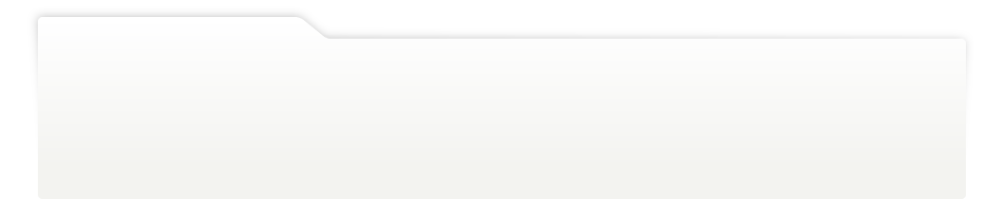
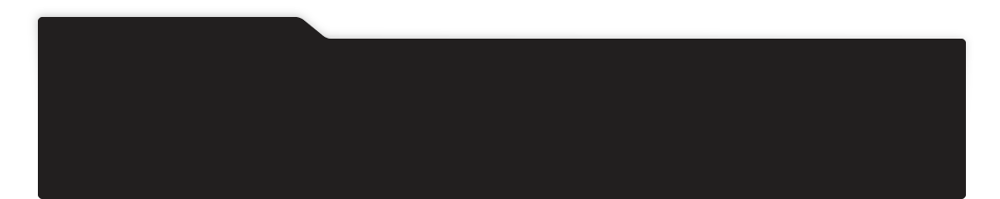
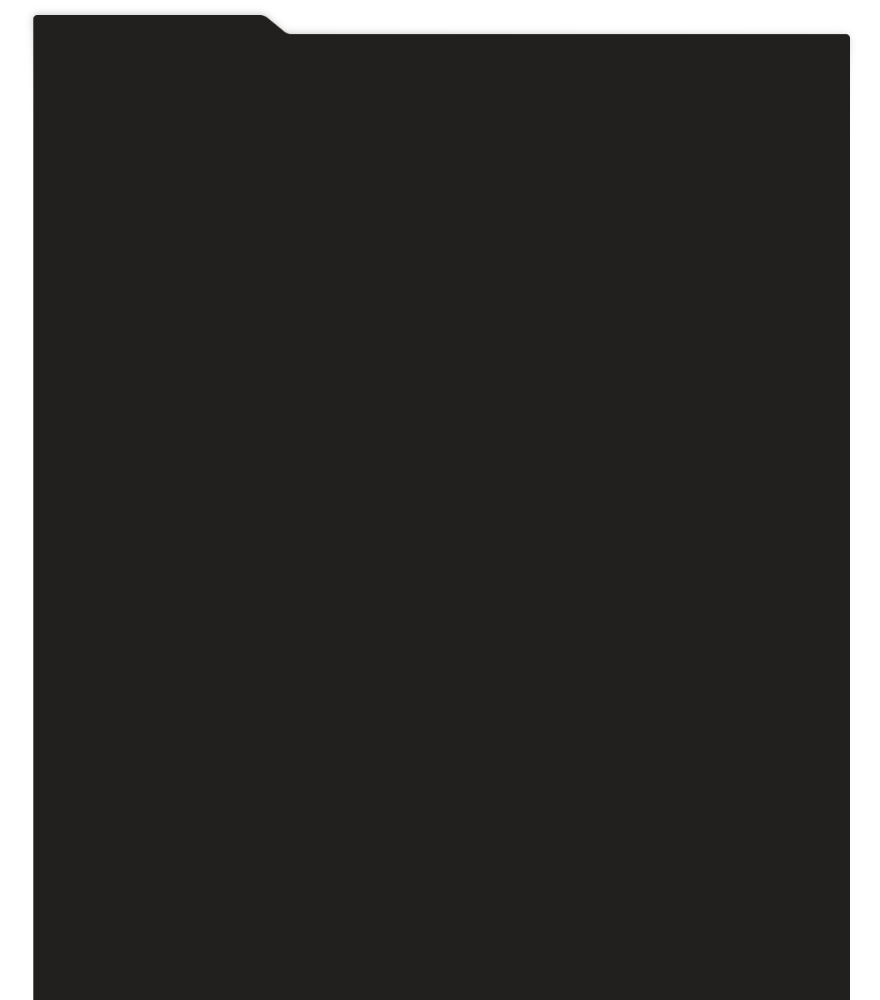
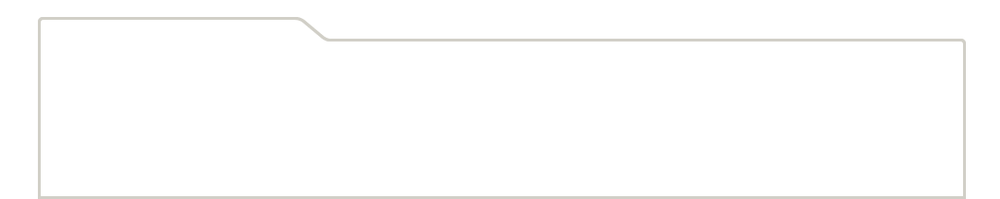
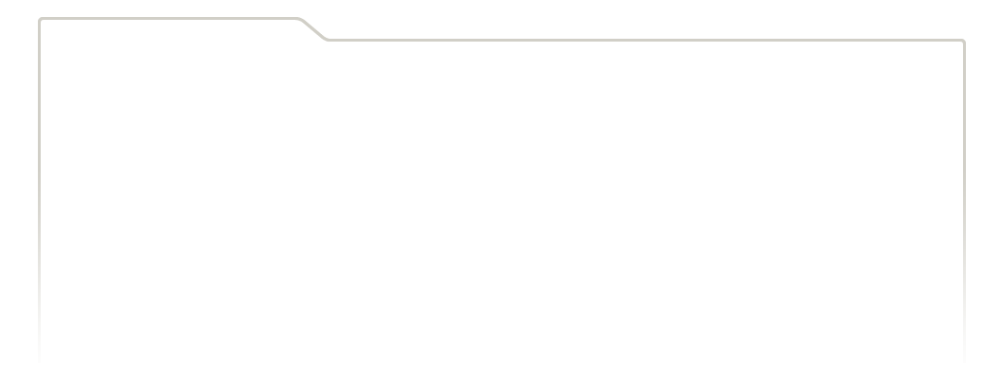
...
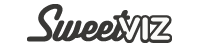
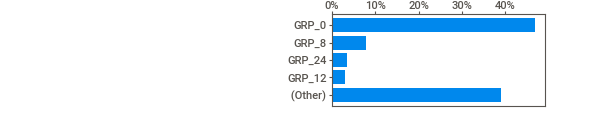
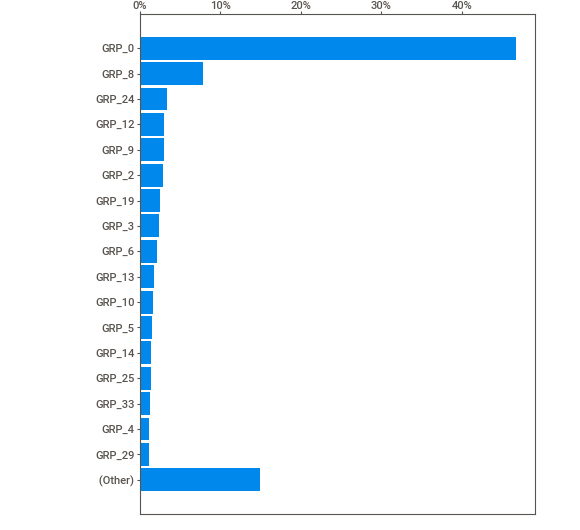
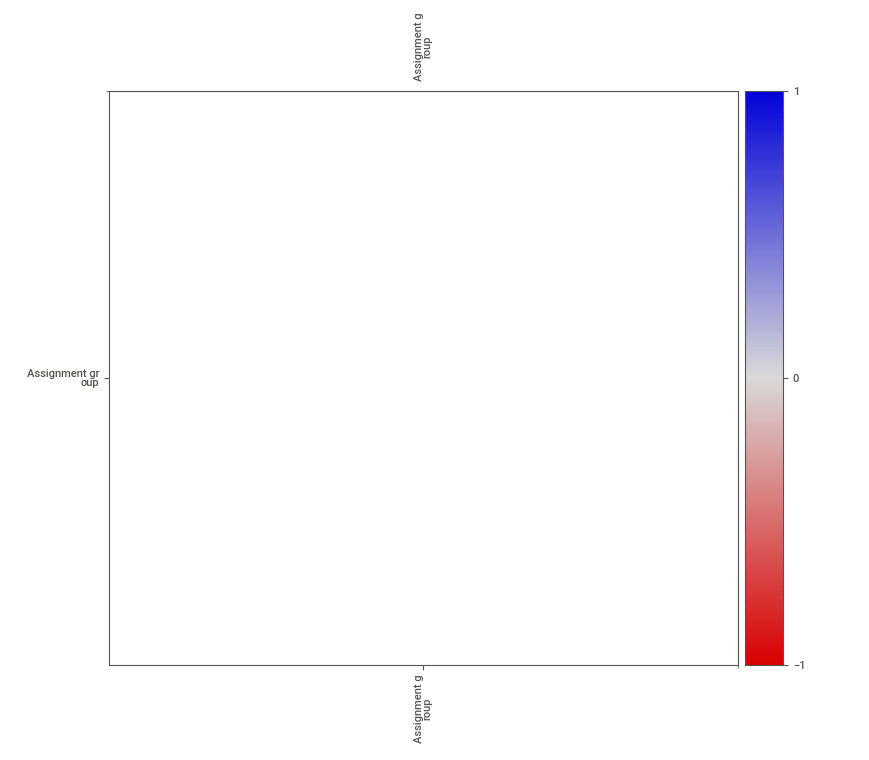
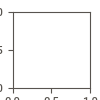

In [19]:
incidents_report = sv.analyze(incidents_data)
#display the report
incidents_report.show_html('Incidents_sweetviz_report.html')
incidents_report.show_notebook()

### 3.4.1.2 Report visualization using Pandas Profiling

In [20]:
incident_report = ProfileReport(incidents_data, html={'style': {'full_width' : True}})
incident_report.to_file(output_file='Incidents_pandas_profiling_report.html')
incident_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/16 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### 3.4.1.3 Observations from SweetViz and Pandas Profiling reports above

From Above two reports we have below onservations: 
1. Shape of the data - { Rows : 8500, Columns : 4 }
2. Total features - 3
    
    2.1. Short Description - Text

    2.2. Description - Text

    2.3. Caller - Text
3. Target Column - 1
  
    3.1 Assignment Group - Categorical
4. There are 84 duplicate records in total. Strategy to handle duplicates and the approach taken is defined in the preprocessing section below.
5. New features are required or not needs to be analyzed further and also to check if below hidden patterns can be figured out: 
          A. Common Issues -> user can be trained if possible 
          B. Common Caller -> May be user needs training or help with hardware or software
          C. #ToDo To find if issue is controllable or not --> Check if possible .
          D. To find if customer is happy with service or needs further imporvement and assistance

Now let's have a look at individual features: 

1. **Short description** 
  
   A. Total values - 8492 ( > 99% )
   
   B. Missing values - 8 ( < 1% )

   C. Distinct values - 7481 (88%)

   D. Mostly occuring value - password reset ( 0.4% )
   
   E. We can also see the number of times each value is being repeated

   F. Max length of statement - 159

   G. It contains:
    
        Characters -> Lowercase Letter, Punctuation, 
        Uppercase Letter, Decimal Number, 
        Math Symbol, Math_Symbol, 
        Modifier Symbol, Other_Number, 
        Other_Symbol, Currency_Symbol

        Scripts -> Common(ASCII) and Latin

  H. Point G indicates that we have to translate the texts in the dataset based on the scripts as part of data preprocessing.

2. **Description** 
  
   A. Total values - 8499 ( > 99% )
   
   B. Missing values - 1 ( < 1% )

   C. Distinct values - 7817 ( 92% )

   D. Mostly occuring value - it shows "the" ( 0.7% ) but will analyze further after the removal of stop words. But we consider the next which is windows password reset ( 0.3% )

   E. We can also see the number of times each value is being repeated

   F. Max length of statement - 13001

   G. It contains:
    
        Characters -> Lowercase Letter, Punctuation, 
        Uppercase Letter, Decimal Number, 
        Math Symbol, Math_Symbol, 
        Modifier Symbol, Other_Number, 
        Other_Symbol, Currency_Symbol

        Scripts -> Common(ASCII) and Latin

  H. Point G indicates that we have to translate the texts in the dataset based on the scripts as part of data preprocessing.

3. **Caller** 
  
   A. Total values - 8500 ( 100% )
   
   B. Missing values - no missing value
 
   C. Distinct values - 2950 ( 35% )

   D. Mostly occuring value - bpctwhsn kzqsbmtp (10%)

   E. We can also see the number of times each value is being repeated

   F. Max length of statement - 30

   G. It contains:
    
        Characters -> Lowercase Letter, Space_Separator, 
        Uppercase Letter, Connector_Punctuation

        Scripts -> Common(ASCII) and Latin

  H. Point G indicates that we have to translate the texts in the dataset based on the scripts as part of data preprocessing.

4. **Assignment Group** 
  
   A. Total values - 8500 ( 100% )
   
   B. Missing values - no missing value 

   C. Distinct values - 74 

   D. Mostly occuring value - GRP_0 (47% ~ nearly half of the data --> Hence we can say that target class is highly imbalanced, so needs a strategy to be employed to reduce the bias here)

   E. We can also see the number of times each value is being repeated

   G. This indicates we can merge few assignment groups with smaller percentage to reduce overall number of categories. 


### 3.4.1.4 Other Observations

1. There are duplicates which needs to be tackled
2. There are mojibake texts in the description and short description which needs to be processed 
3. There are texts belonging to different languages which needs translations
4. There are email ids, blank spaces, dates, numbers which needs to be processed
5. There are missing values to be treated


## 3.4.2 Further data analysis 

In [13]:
# Print the counts for unique values of short description
incidents_data['Short description'].value_counts()

password reset                                             38
windows password reset                                     29
account locked in ad                                       24
windows account locked                                     23
erp SID_34 account unlock                                  19
                                                           ..
unable to get on network drives                             1
new order--mm# 2694571 dmhpm045 / mm# 2695539  mb033        1
machine nÃ£o estÃ¡ funcionando                              1
vitalyst transfer:  crm calendar not showing on outlook     1
unable to log into skype. certificate error.                1
Name: Short description, Length: 7481, dtype: int64

Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance.

In [11]:
?WordCloud

In [9]:
#Generic method to display WordCloud
def show_word_cloud(column):
    comment_words = ' '
    stopwords = set(STOPWORDS)
    #stopwords.update(["yes", "na"])

    # iterate through the csv file 
    for val in column: 

        # typecaste each val to string 
        val = str(val) 

        # split the value 
        tokens = val.split() 

        # Converts each token into lowercase
        for i in range(len(tokens)):
            tokens[i] = tokens[i].lower()
          
        comment_words += " ".join(tokens)+" "
  
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    stopwords = stopwords,
                    max_words = 100,
                    min_font_size = 10).generate(comment_words) 
    
    return wordcloud

Let's now check the wordclouds for Short description and Description features.

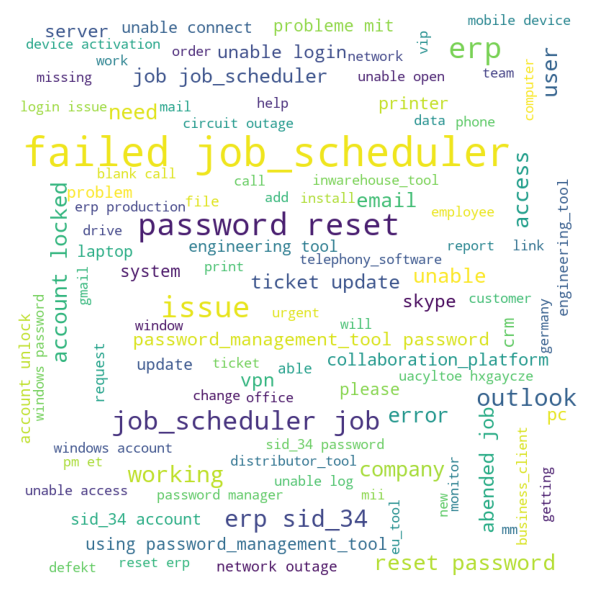

In [10]:
#Word cloud for Short Description

wordcloud_short_desc = show_word_cloud(incidents_data['Short description'])
# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud_short_desc) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.show()

In [31]:
# Print the counts for unique values of Description
incidents_data["Description"].value_counts()

the                                                                                                                                                                                                                                                                                                                                                                                                                  56
windows password reset                                                                                                                                                                                                                                                                                                                                                                                               29
password reset                                                                                                                                                                          

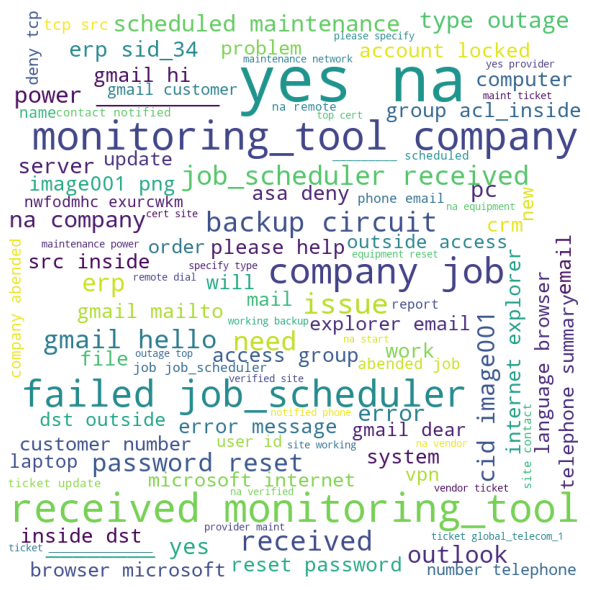

In [11]:
#Word cloud for Description

wordcloud_desc = show_word_cloud(incidents_data['Description'])
# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud_desc) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

In [33]:
# Print the counts for unique values of Caller
incidents_data["Caller"].value_counts()

bpctwhsn kzqsbmtp    810
ZkBogxib QsEJzdZO    151
fumkcsji sarmtlhy    134
rbozivdq gmlhrtvp     87
rkupnshb gsmzfojw     71
                    ... 
dpohqclx wzvihrdy      1
dvzgjsom ynpxqjlf      1
oqbstujm sutjvker      1
tfbvqliw xrqimykt      1
woxrljif qymrszdk      1
Name: Caller, Length: 2950, dtype: int64

In [17]:
# Fetching top 10 Callers
caller_counts = incidents_data["Caller"].value_counts().reset_index()
top_ten_callers = caller_counts[:10].copy()

In [18]:
print ( "Top 10 Callers")
top_ten_callers

Top 10 Callers


,index,Caller
0,bpctwhsn kzqsbmtp,810
1,ZkBogxib QsEJzdZO,151
2,fumkcsji sarmtlhy,134
3,rbozivdq gmlhrtvp,87
4,rkupnshb gsmzfojw,71
5,jloygrwh acvztedi,64
6,spxqmiry zpwgoqju,63
7,oldrctiu bxurpsyi,57
8,olckhmvx pcqobjnd,54
9,jyoqwxhz clhxsoqy,51


In [19]:
if len(caller_counts) > 20:
  remaining_caller_df = pd.DataFrame({"index":['Other callers'],
                                      "Caller":sum(caller_counts.Caller[10:]) })

In [20]:
top_ten_callers_data = top_ten_callers.append(remaining_caller_df, ignore_index=True, sort=True)

In [27]:
top_ten_callers_data.iplot(kind='pie',
         labels='index', 
         values='Caller',
         title = 'Assignment group distribution of top 10 callers as compared to other callers')

From the above we can say that 9.53% of requests are from Caller "**bpctwhsn kzqsbmtp**". May be this user needs some training or might be facing more issues compared to other callers.

Now lets also check the disbribution of top 10 callers amongst themselves.

In [23]:
caller_data = pd.DataFrame(incidents_data.groupby(['Caller']).size().nlargest(10), columns=['Count']).reset_index()
caller_data.sort_values(by=['Count'])
caller_data.iplot(kind='pie',
         labels='Caller', 
         values='Count',
         title = 'Assignment Group distribution amongst the top 10 callers')

From this we can see the distribution amongst the top 10 callers which indicates that Caller "**bpctwhsn kzqsbmtp**" has created about 52.5% of issues.

## 3.4.3 Target group analysis 

In [24]:
# Print the counts for unique values of Assignment Group
incidents_data['Assignment group'].value_counts()

GRP_0     3976
GRP_8      661
GRP_24     289
GRP_12     257
GRP_9      252
          ... 
GRP_73       1
GRP_64       1
GRP_61       1
GRP_67       1
GRP_70       1
Name: Assignment group, Length: 74, dtype: int64

In [57]:
fig = px.histogram(incidents_data,x='Assignment group',barmode='group',color='Assignment group')
fig.update_layout(
    title_text='Assignment group distribution', # title of plot
    width=1000,
    height=1000,
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

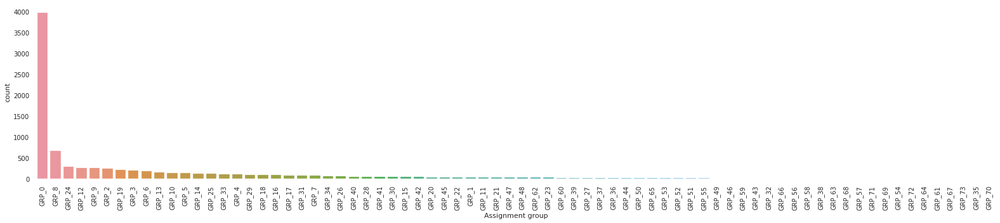

In [25]:
#Visualizing imbalance in the target class to find what all are smallest groups that can be merged to reduce total number of classification classes.
plt.figure(figsize=(22,5))
sortOrder = incidents_data['Assignment group'].value_counts().sort_values(ascending=False).index
ax = sns.countplot(x='Assignment group', data=incidents_data,order=sortOrder)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.tight_layout()
plt.show()


In [59]:
ticket_selected_grp = incidents_data.groupby(['Assignment group']).filter(lambda x: len(x) <=30)
print("No of Assignment groups with less than or equal to 30 tickets", ticket_selected_grp['Assignment group'].nunique())


No of Assignment groups with less than or equal to 30 tickets 40


Now lets see the distribution of tickets for groups other than GRP_0, GRP_8 and Groups having tickets <=30.

---





In [60]:
ticket_excluded_grp = ['GRP_0','GRP_8']
ticket_excluded_grp.extend(ticket_selected_grp['Assignment group'].unique())

ticket_excluded_grps = incidents_data[~incidents_data['Assignment group'].isin(ticket_excluded_grp)]

ticket_assigned_grp = pd.DataFrame(ticket_excluded_grps.groupby('Assignment group').size(),columns=['Count']).reset_index()
ticket_assigned_grp.sort_values(by=['Assignment group'])

,Assignment group,Count
0,GRP_1,31
1,GRP_10,140
2,GRP_12,257
3,GRP_13,145
4,GRP_14,118
5,GRP_15,39
6,GRP_16,85
7,GRP_17,81
8,GRP_18,88
9,GRP_19,215


In [62]:
ticket_assigned_grp.iplot(kind='pie',
         labels='Assignment group', 
         values='Count',
         title = 'Assignment groups Distribution except GRP_0 and GRP_8 and Groups having ticket count <= 30')

In [63]:
incidents_data_counts = incidents_data['Assignment group'].value_counts().reset_index()

In [64]:
incidents_data_counts.head()

,index,Assignment group
0,GRP_0,3976
1,GRP_8,661
2,GRP_24,289
3,GRP_12,257
4,GRP_9,252


We can use above figure to define the ranges to see which groups have tickets in below range. This will help us understand the most important groups to focus on. The ranges can be as below: 
1. 1 ticket
2. 2 tickets
3. 3-8 tickets
4. 9-14 tickets
5. 15-30 tickets
6. 31-50 tickets
7. 51-100 tickets
8. 101-200 tickets
9. 201-300 tickets
10. more than 300 tickets

In [65]:
ticket_bins = pd.DataFrame(columns=['No. of tickets','No. of Assignment groups'])
_1_ticket = {'No. of tickets':'1 ticket','No. of Assignment groups':len(incidents_data_counts[incidents_data_counts['Assignment group'] == 1])}
_2_tickets = {'No. of tickets':'2 tickets',
              'No. of Assignment groups':len(incidents_data_counts[incidents_data_counts['Assignment group'] == 2 ])}
_3_8_tickets = {'No. of tickets':' 3-8 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 2 )& (incidents_data_counts['Assignment group'] < 9 )])}
_9_14_tickets = {'No. of tickets':' 9-14 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 8)& (incidents_data_counts['Assignment group'] < 15 )])}
_15_30_tickets = {'No. of tickets':' 15-30 ticket',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 14)& (incidents_data_counts['Assignment group'] < 31 )])}      
_31_50_tickets = {'No. of tickets':' 31-50 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 30)& (incidents_data_counts['Assignment group'] < 51)])}      
_51_100_tickets = {'No. of tickets':' 51-100 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 50)& (incidents_data_counts['Assignment group'] < 101)])}   
_101_200_tickets = {'No. of tickets':' 101-200 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 100)& (incidents_data_counts['Assignment group'] < 201)])}
_201_300_tickets = {'No. of tickets':' 201-300 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 200)& (incidents_data_counts['Assignment group'] < 301)])}                                                       
_301_tickets = {'No. of tickets':' > 301 tickets',
              'No. of Assignment groups':len(incidents_data_counts[(incidents_data_counts['Assignment group'] > 300)])}
# Append row to the bins
ticket_bins = ticket_bins.append([_1_ticket,_2_tickets,_3_8_tickets,
                          _9_14_tickets,_15_30_tickets,_31_50_tickets,_51_100_tickets,_101_200_tickets,_201_300_tickets,_301_tickets], ignore_index=True)

print(ticket_bins)

     No. of tickets No. of Assignment groups
0          1 ticket                        6
1         2 tickets                        5
2       3-8 tickets                       13
3      9-14 tickets                        4
4      15-30 ticket                       12
5     31-50 tickets                       10
6    51-100 tickets                        9
7   101-200 tickets                        8
8   201-300 tickets                        5
9     > 301 tickets                        2


There are total of 40 Assignment groups which have tickets less than  or equal to 30. Lets see the if we can combine the assignment groups having few tickets and reduce the number of classes for classification. 

For this we shall also check if the same kind of issues are handled by other assignment groups in further analysis with which will be a deciding factor to merge the classes.

Let's see the assignment group distribution for the range of ticksts we see above in the form of pie chart

In [67]:
ticket_bins.sort_values(by=['No. of Assignment groups'])
ticket_bins.iplot(kind='pie',
         labels='No. of tickets', 
         values='No. of Assignment groups',
         title = 'Assignment Group Distribution in the form of ticket bins')

From the above chart, we can see that 
Assignment group <= 2 tickets contributes to 14.87% ie(8.11 + 6.76%). 
Lets analyze this further.

In [68]:
ticket_selected_grp = incidents_data.groupby(['Assignment group']).filter(lambda x: len(x) <=2)
print("No of Assignment groups with less than or equal to 2 tickets", ticket_selected_grp['Assignment group'].nunique())


No of Assignment groups with less than or equal to 2 tickets 11


In [69]:
assignment_group_ticket_counts = incidents_data_counts[incidents_data_counts['index'].isin(ticket_selected_grp['Assignment group'])]

In [71]:
print("Assignment group with ticket count less than or equal to 2")
assignment_group_ticket_counts

Assignment group with ticket count less than or equal to 2


,index,Assignment group
63,GRP_57,2
64,GRP_71,2
65,GRP_69,2
66,GRP_54,2
67,GRP_72,2
68,GRP_35,1
69,GRP_73,1
70,GRP_64,1
71,GRP_61,1
72,GRP_67,1


Let's see if the tickets to these groups can also be handled by some other assignment groups. May be then we can ignore those groups and reduce the classes.

In [73]:
incidents_data[incidents_data['Assignment group']=='GRP_57']['Short description']

1886    i cannot access the dob report.  i was able to...
6839    job Job_1148 failed in job_scheduler at: 08/22...
Name: Short description, dtype: object

In [74]:
groups = incidents_data["Short description"].str.contains("job_scheduler").reset_index()

In [75]:
group_desc = groups[groups['Short description'] == True]

group_desc

,index,Short description
47,47,True
50,50,True
59,59,True
60,60,True
67,67,True
...,...,...
8442,8442,True
8448,8448,True
8460,8460,True
8462,8462,True


In [76]:
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

GRP_8     418
GRP_9     184
GRP_6     117
GRP_5     114
GRP_10     63
GRP_60     13
GRP_47     12
GRP_45      8
GRP_12      8
GRP_1       7
GRP_13      4
GRP_18      3
GRP_29      3
GRP_14      3
GRP_57      1
GRP_44      1
Name: Assignment group, dtype: int64

In [77]:
group_ignored_cols=["Group", "Can be ignored"]
group_ignored_df = pd.DataFrame(columns=group_ignored_cols)

In [78]:
group_ignored_col1 = pd.DataFrame([["GRP_57","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_57 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_57 are assigned to

In [ ]:
group_ignored_df

,Group,Can be ignored
0,GRP_57,Yes


In [79]:
print(incidents_data[incidents_data['Assignment group']=='GRP_71']['Short description'])


7597                     na production files not received
8099    emea files not processed as per schedule - che...
Name: Short description, dtype: object


In [80]:
groups = incidents_data["Short description"].str.contains("files not").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
7597   7597              True
8099   8099              True


GRP_71    2
Name: Assignment group, dtype: int64

In [82]:
group_ignored_col1 = pd.DataFrame([["GRP_71","No"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_71 cannot be ignored** as there are no other groups which have the capabiltiy to handle issues which GRP_71 are assigned to

In [83]:
group_ignored_df

,Group,Can be ignored
0,GRP_57,Yes
0,GRP_71,No
0,GRP_71,No


In [84]:
print(incidents_data[incidents_data['Assignment group']=='GRP_72']['Short description'])


7828                                      account locked.
8387    ticket (ticket_no1538972) update to anftgup nf...
Name: Short description, dtype: object


In [85]:
groups = incidents_data["Short description"].str.contains("account locked").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
18       18              True
27       27              True
54       54              True
81       81              True
165     165              True
...     ...               ...
8267   8267              True
8268   8268              True
8367   8367              True
8458   8458              True
8489   8489              True

[184 rows x 2 columns]


GRP_0     181
GRP_2       1
GRP_72      1
GRP_34      1
Name: Assignment group, dtype: int64

In [86]:
group_ignored_col1 = pd.DataFrame([["GRP_72","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_72 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_72 are assigned to

In [87]:
print(incidents_data[incidents_data['Assignment group']=='GRP_54']['Short description'])

1637    receiving product in logical warehouse (plant_...
2983    question  -  who is taking care on report zzsd...
Name: Short description, dtype: object


In [88]:
groups = incidents_data["Short description"].str.contains("warehouse").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
215     215              True
329     329              True
504     504              True
685     685              True
935     935              True
...     ...               ...
8030   8030              True
8035   8035              True
8038   8038              True
8044   8044              True
8192   8192              True

[81 rows x 2 columns]


GRP_13    30
GRP_8     14
GRP_0      9
GRP_10     8
GRP_18     5
GRP_20     3
GRP_29     2
GRP_7      2
GRP_4      2
GRP_2      1
GRP_19     1
GRP_3      1
GRP_32     1
GRP_54     1
GRP_25     1
Name: Assignment group, dtype: int64

In [90]:
group_ignored_col1 = pd.DataFrame([["GRP_54","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_54 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_54 are assigned to

In [92]:
print(incidents_data[incidents_data['Assignment group']=='GRP_69']['Short description'])

5843              'repeat outbound connection for 135/tcp
7154    security incidents - ( #in33417637 ) : repeat ...
Name: Short description, dtype: object


In [94]:
groups = incidents_data["Short description"].str.contains("connection").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
73       73              True
323     323              True
522     522              True
575     575              True
763     763              True
...     ...               ...
7589   7589              True
7632   7632              True
7835   7835              True
7870   7870              True
8247   8247              True

[66 rows x 2 columns]


GRP_0     29
GRP_2      6
GRP_4      6
GRP_19     5
GRP_31     5
GRP_3      4
GRP_69     2
GRP_8      2
GRP_55     1
GRP_53     1
GRP_1      1
GRP_28     1
GRP_45     1
GRP_50     1
GRP_30     1
Name: Assignment group, dtype: int64

In [95]:
group_ignored_col1 = pd.DataFrame([["GRP_69","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_69 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_69 are assigned to

In [96]:
print(incidents_data[incidents_data['Assignment group']=='GRP_64']['Short description'])

3628    r: ticket_no1402627 change in report zsdslsum ...
Name: Short description, dtype: object


In [97]:
groups = incidents_data["Short description"].str.contains("change in report").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
3628   3628              True


GRP_64    1
Name: Assignment group, dtype: int64

In [99]:
group_ignored_col1 = pd.DataFrame([["GRP_64","No"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_64 cannot be ignored** as there are no other groups which have the capabiltiy to handle issues which GRP_64 are assigned to

In [100]:
print(incidents_data[incidents_data['Assignment group']=='GRP_73']['Short description'])

8197    oneteam sso not working
Name: Short description, dtype: object


In [101]:
groups = incidents_data["Short description"].str.contains("oneteam").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
7967   7967              True
8197   8197              True
8211   8211              True
8478   8478              True


GRP_0     3
GRP_73    1
Name: Assignment group, dtype: int64

In [ ]:
group_ignored_col1 = pd.DataFrame([["GRP_73","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_73 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_73 are assigned to

In [102]:
print(incidents_data[incidents_data['Assignment group']=='GRP_61']['Short description'])

3036    (srvlavpwdrprd01.company.company.com) is not r...
Name: Short description, dtype: object


In [ ]:
groups = incidents_data["Short description"].str.contains("srvlavpwdrprd01").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
3036   3036              True


GRP_61    1
Name: Assignment group, dtype: int64

In [103]:
group_ignored_col1 = pd.DataFrame([["GRP_61","No"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_61 cannot be ignored** as there are no other groups which have the capabiltiy to handle issues which GRP_61 are assigned to

In [104]:
print(incidents_data[incidents_data['Assignment group']=='GRP_70']['Short description'])

6401    a link on an e-mail says i am "forbidden"
Name: Short description, dtype: object


In [105]:
groups = incidents_data["Short description"].str.contains("forbidden").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
6401   6401              True


GRP_70    1
Name: Assignment group, dtype: int64

In [106]:
group_ignored_col1 = pd.DataFrame([["GRP_70","No"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

In [107]:
print(incidents_data[incidents_data['Assignment group']=='GRP_67']['Short description'])

5154    unable to complete forecast
Name: Short description, dtype: object


In [108]:
groups = incidents_data["Short description"].str.contains("forecast").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
2419   2419              True
2425   2425              True
5154   5154              True
7328   7328              True
7403   7403              True


GRP_22    3
GRP_40    1
GRP_67    1
Name: Assignment group, dtype: int64

In [109]:
group_ignored_col1 = pd.DataFrame([["GRP_67","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_67 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_67 are assigned to

In [110]:
print(incidents_data[incidents_data['Assignment group']=='GRP_35']['Short description'])

401    need access to erp kp06789
Name: Short description, dtype: object


In [111]:
groups = incidents_data["Short description"].str.contains("erp").reset_index()
group_desc = groups[groups['Short description'] == True]
print(group_desc)
incidents_data_grp = incidents_data.loc[group_desc.index]
incidents_data_grp['Assignment group'].value_counts()

      index Short description
6         6              True
18       18              True
25       25              True
29       29              True
36       36              True
...     ...               ...
8453   8453              True
8454   8454              True
8459   8459              True
8488   8488              True
8493   8493              True

[879 rows x 2 columns]


GRP_0     591
GRP_2      55
GRP_14     34
GRP_13     20
GRP_10     15
GRP_15     11
GRP_24     10
GRP_18     10
GRP_9       9
GRP_8       9
GRP_11      8
GRP_25      8
GRP_45      7
GRP_5       7
GRP_29      7
GRP_40      6
GRP_19      6
GRP_3       6
GRP_41      5
GRP_4       5
GRP_6       5
GRP_42      4
GRP_31      4
GRP_20      4
GRP_28      3
GRP_53      3
GRP_47      3
GRP_30      3
GRP_1       3
GRP_44      2
GRP_33      2
GRP_52      2
GRP_21      2
GRP_59      2
GRP_49      2
GRP_16      1
GRP_61      1
GRP_26      1
GRP_35      1
GRP_12      1
GRP_46      1
Name: Assignment group, dtype: int64

In [112]:
group_ignored_col1 = pd.DataFrame([["GRP_35","Yes"]], columns=group_ignored_cols)
group_ignored_df = group_ignored_df.append(group_ignored_col1)

We see from above that **GRP_35 can be ignored** as there are other groups which have the capabiltiy to handle issues which GRP_35 are assigned to

In [113]:
group_ignored_df

,Group,Can be ignored
0,GRP_57,Yes
0,GRP_71,No
0,GRP_71,No
0,GRP_72,Yes
0,GRP_54,Yes
0,GRP_54,Yes
0,GRP_69,Yes
0,GRP_64,No
0,GRP_64,No
0,GRP_61,No


So finally, we see that below groups can be ignored based on above analysis. We will decide this later post feature engineering
1. GRP_72
2. GRP_54
3. GRP_57
4. GRP_69
5. GRP_67
6. GRP_35
7. GRP_73

But, we shall not ignore below assignment groups:
1. GRP_71
2. GRP_70
3. GRP_61
4. GRP_64

# 3.5 FEATURE ENGINEERING

## 3.5.1 Checking null values

In [12]:
# Print the null values from data
incidents_data.isnull().sum()

Short description    8
Description          1
Caller               0
Assignment group     0
dtype: int64

## 3.5.2 Null value treatment strategies

We see there are arond 9 records with null values. Hence we can use below strategies to replace null values:
1. Drop the records with null values
2. Replace null value (NaN) with empty string
3. Look for same description in any other record and then replace the corresponding shor description or in case of description has null value then search for same short description and replace description with corresponding description

We will go with approach 2 here that we will replace the null values with empty string. This is because we do not want to loose descriptions with dropping and with approach 3 we might end up creating further duplicates inside.

So let's replce NaN with empty strings

## 3.5.3 Replacing Null values with blank

In [13]:
# Replace null(NaN) values from short description and descriptions
incidents_data['Short description'] = incidents_data['Short description'].replace(np.nan, '', regex=True)
incidents_data['Description'] = incidents_data['Description'].replace(np.nan, '', regex=True)

## 3.5.4 Checking null values after treatment

In [15]:
# Print the null values from data
incidents_data.isnull().sum()

Short description    0
Description          0
Caller               0
Assignment group     0
dtype: int64

So, as we expected there are no null values inside our dataset now

We also saw  during analysis that there are multiple scripts inside and also latin characters. Let's see if we have texts from different langauges. For this first we shall create only single column for both short description and description and Name it as Ticket_description

# 3.5.5 Removal of Duplicate records

## 3.5.6 Merging Short description and Description features into single feature

In [16]:
incidents_data['Ticket_Description'] = incidents_data['Short description'] + ' ' +incidents_data['Description']

In [17]:
incidents_data.head()

,Short description,Description,Caller,Assignment group,Ticket_Description
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0,login issue -verified user details.(employee# ...
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0,outlook \r\n\r\nreceived from: hmjdrvpb.komuay...
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0,cant log in to vpn \r\n\r\nreceived from: eylq...
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr_tool page unable to access...
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error


A new column Ticket_Description is added now. 
We can now use this newly created feature for Data Preprocessing.

## 3.5.6 Word clouds for each assignment group

Function uses three arguments 
1. Dataset 
2. Text Column 
3. Group name

show_word_cloud : It uses existing function which shows wordcloud for text.
Invoke function e.g. wordCloudForGroup(incidents_data,"Description","GRP_0")

In [122]:
def wordCloudForGroup(dataframe,textColumnName,groupName):
    listOfColumns = dataframe['Assignment group'].unique()
    for colmn in listOfColumns:
      if colmn == groupName:
         print("Value Match",colmn) 
         groupRecords = dataframe.loc[dataframe['Assignment group'] == colmn ]
         wordcloud_desc = show_word_cloud(groupRecords[textColumnName])
         # plot the WordCloud image  
         print("WordCloud Chart For:",colmn)                      
         plt.figure(figsize = (8, 8), facecolor = None) 
         plt.imshow(wordcloud_desc) 
         plt.axis("off") 
         plt.tight_layout(pad = 0)      
         plt.show()
         print("\n")

Assigment Group :  0
Value Match GRP_0
WordCloud Chart For: GRP_0


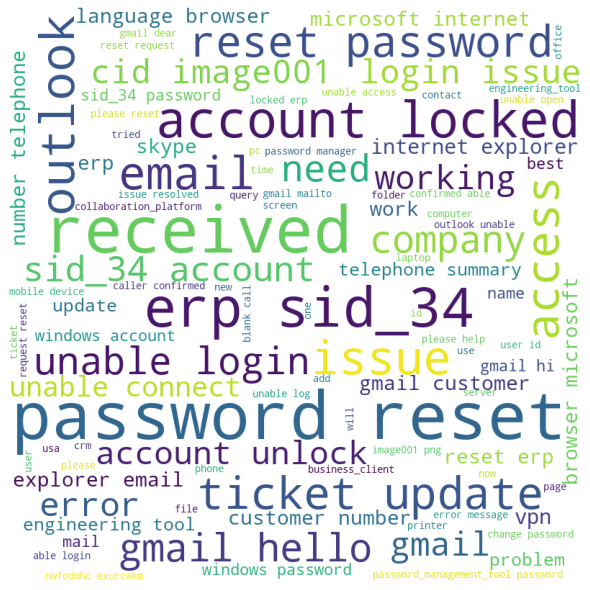



Assigment Group :  1
Value Match GRP_1
WordCloud Chart For: GRP_1


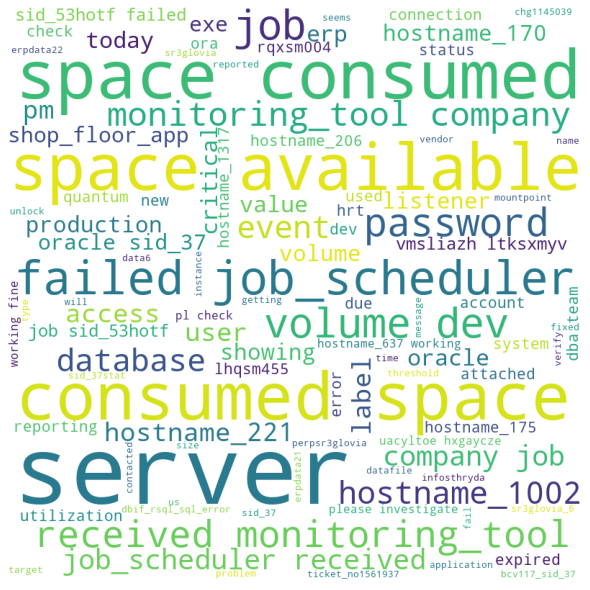



Assigment Group :  2
Value Match GRP_2
WordCloud Chart For: GRP_2


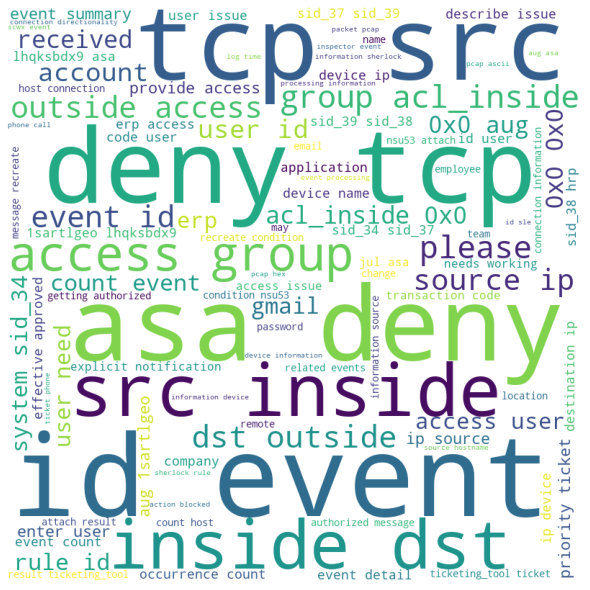



Assigment Group :  3
Value Match GRP_3
WordCloud Chart For: GRP_3


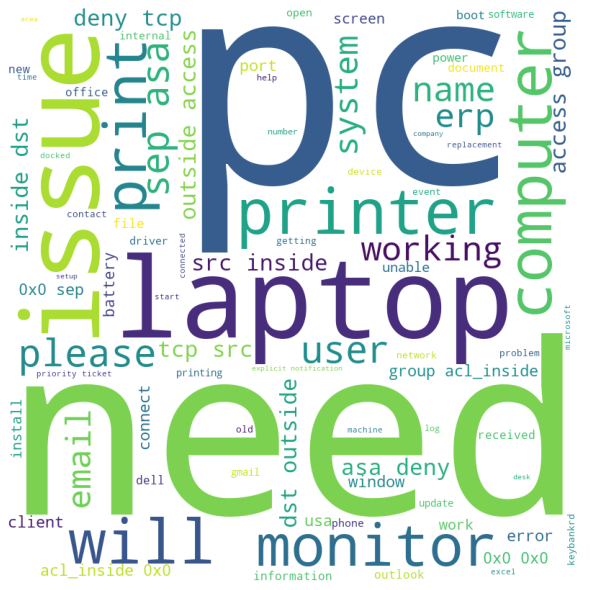



Assigment Group :  4
Value Match GRP_4
WordCloud Chart For: GRP_4


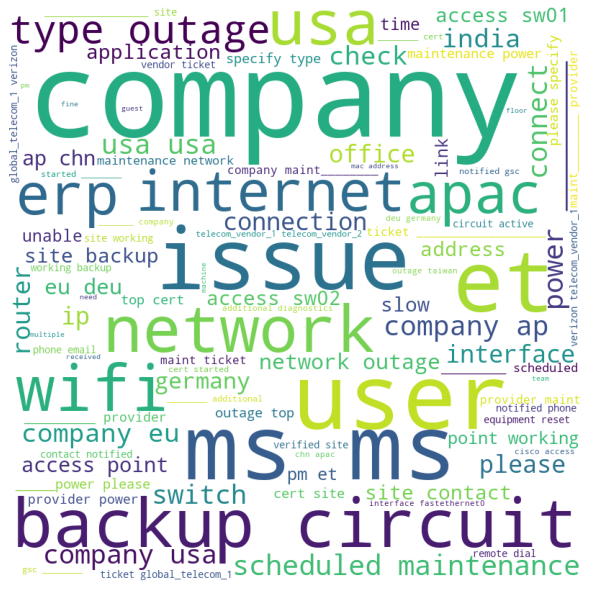



Assigment Group :  5
Value Match GRP_5
WordCloud Chart For: GRP_5


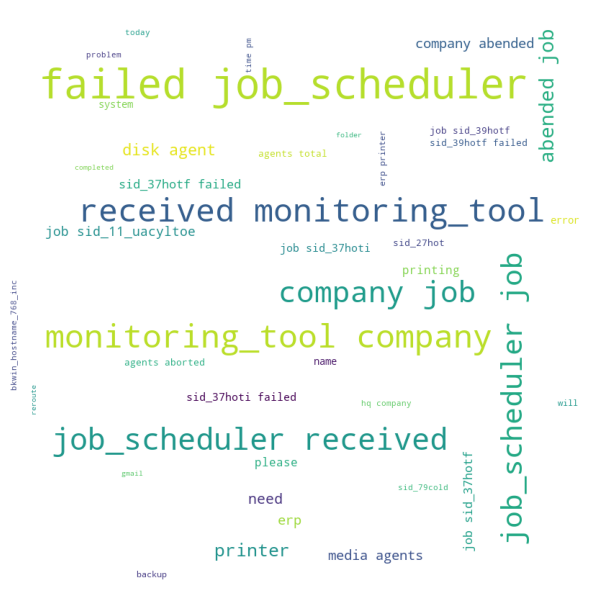



Assigment Group :  6
Value Match GRP_6
WordCloud Chart For: GRP_6


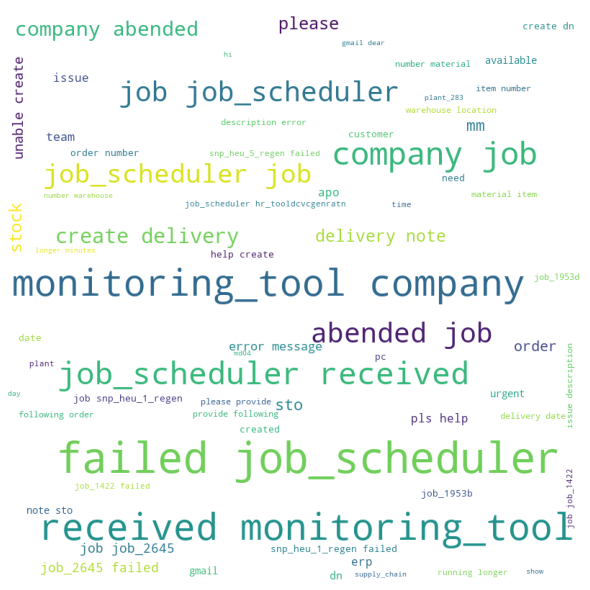



Assigment Group :  7
Value Match GRP_7
WordCloud Chart For: GRP_7


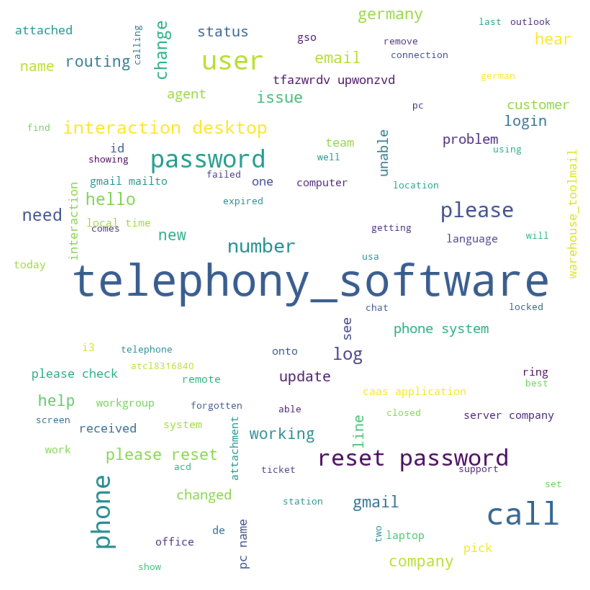



Assigment Group :  8
Value Match GRP_8
WordCloud Chart For: GRP_8


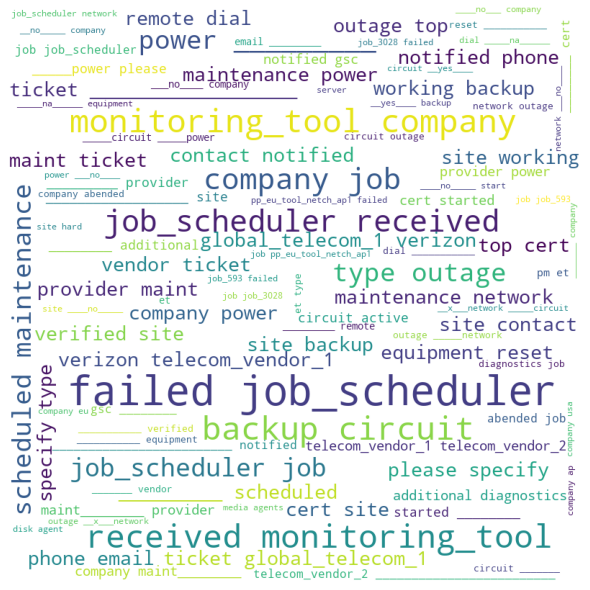



Assigment Group :  9
Value Match GRP_9
WordCloud Chart For: GRP_9


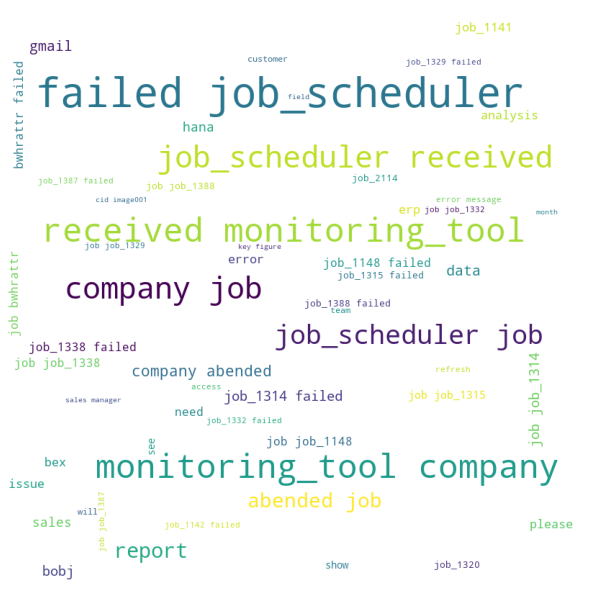



Assigment Group :  10
Value Match GRP_10
WordCloud Chart For: GRP_10


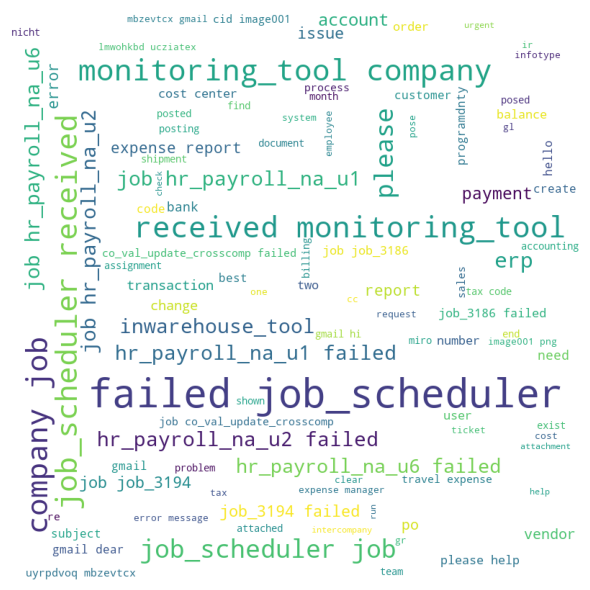



Assigment Group :  11
Value Match GRP_11
WordCloud Chart For: GRP_11


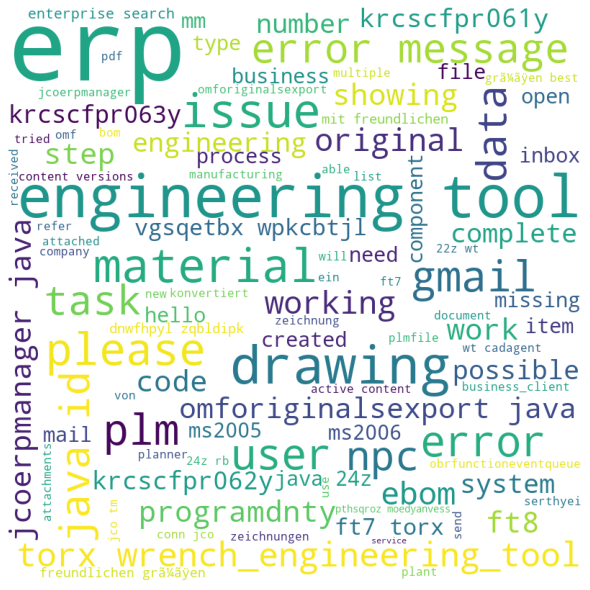



Assigment Group :  12
Value Match GRP_12
WordCloud Chart For: GRP_12


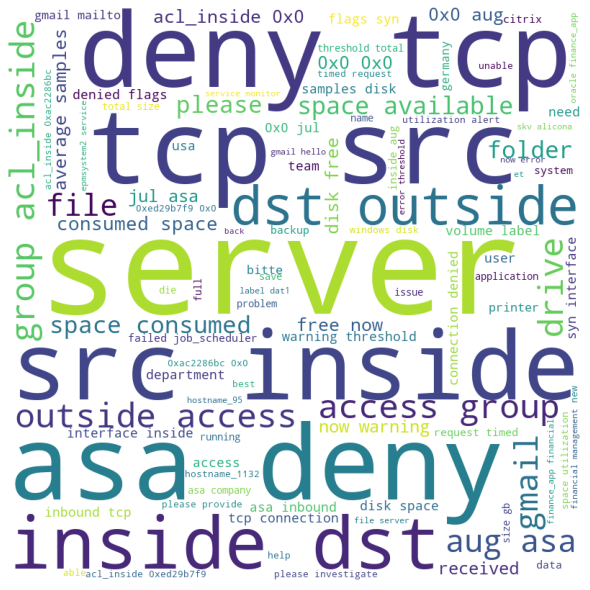



Assigment Group :  13
Value Match GRP_13
WordCloud Chart For: GRP_13


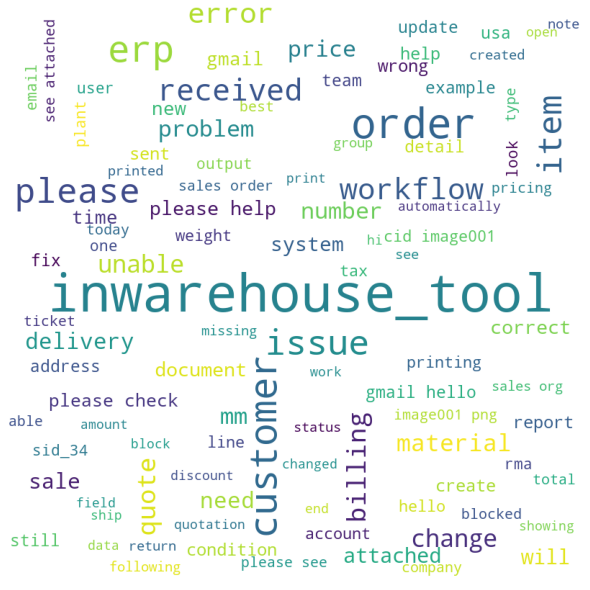



Assigment Group :  14
Value Match GRP_14
WordCloud Chart For: GRP_14


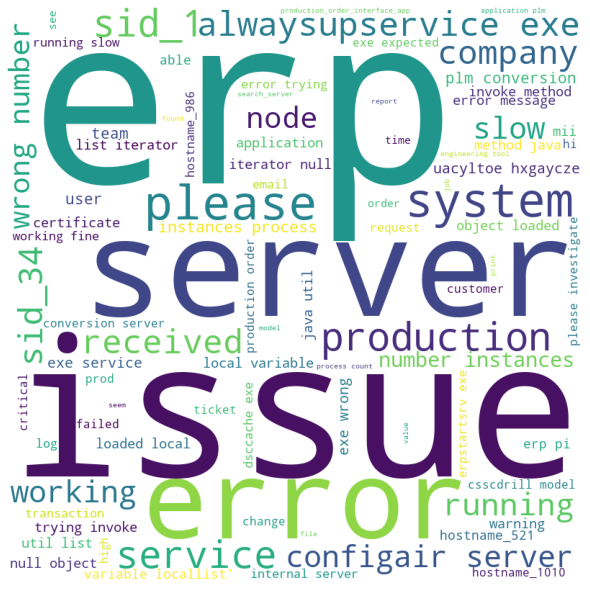



Assigment Group :  15
Value Match GRP_15
WordCloud Chart For: GRP_15


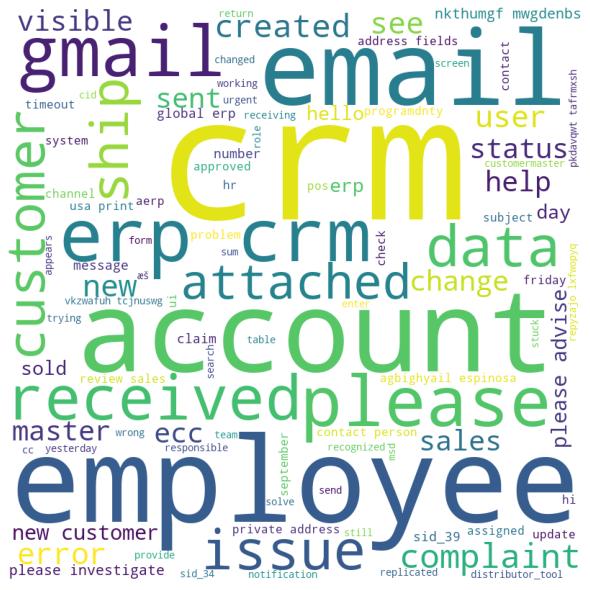



Assigment Group :  16
Value Match GRP_16
WordCloud Chart For: GRP_16


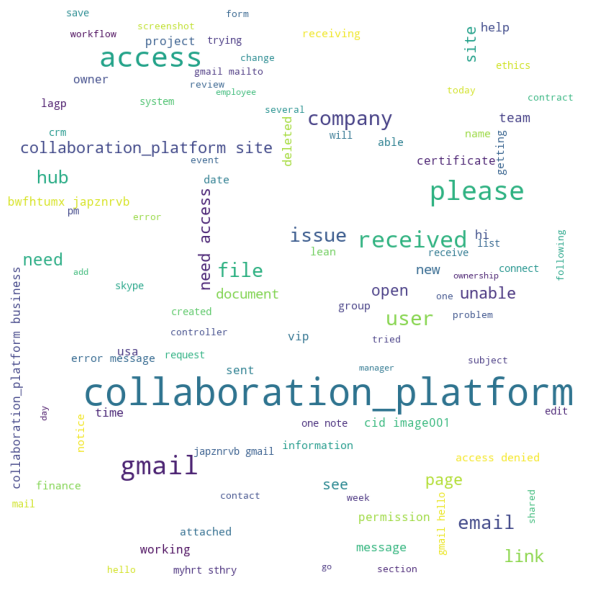



Assigment Group :  17
Value Match GRP_17
WordCloud Chart For: GRP_17


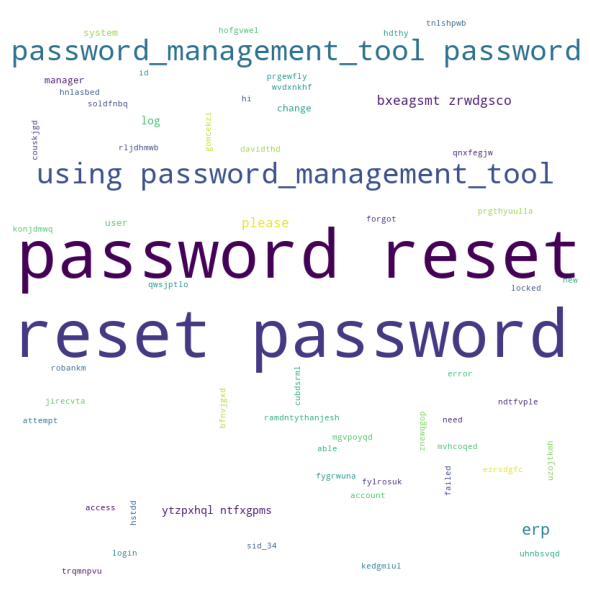



Assigment Group :  18
Value Match GRP_18
WordCloud Chart For: GRP_18


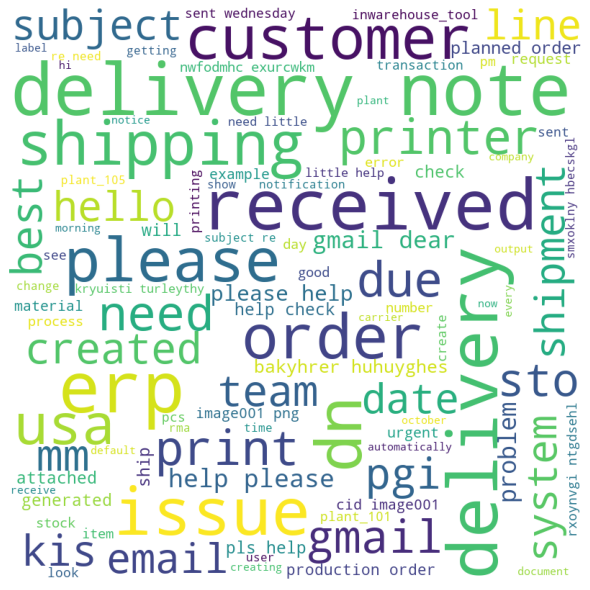



Assigment Group :  19
Value Match GRP_19
WordCloud Chart For: GRP_19


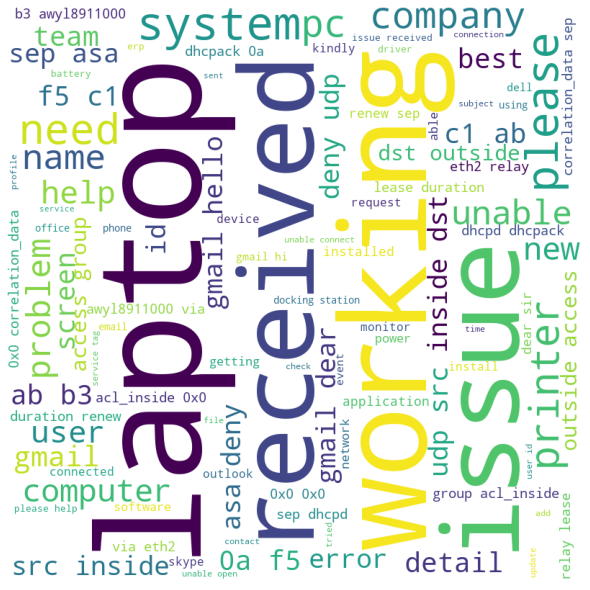



Assigment Group :  20
Value Match GRP_20
WordCloud Chart For: GRP_20


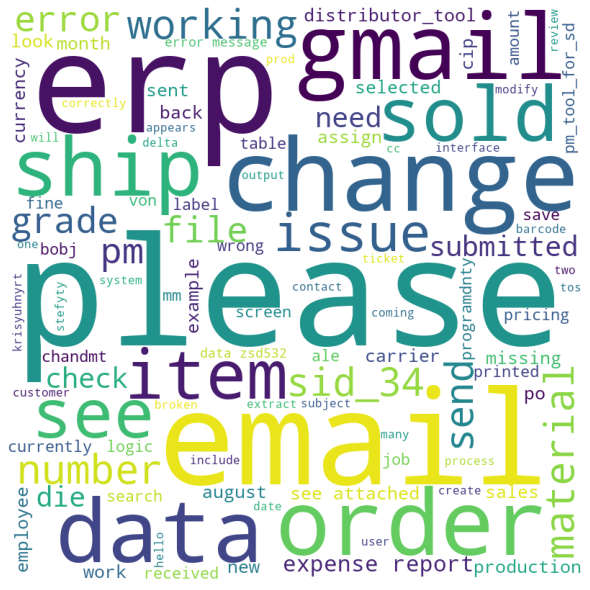



Assigment Group :  21
Value Match GRP_21
WordCloud Chart For: GRP_21


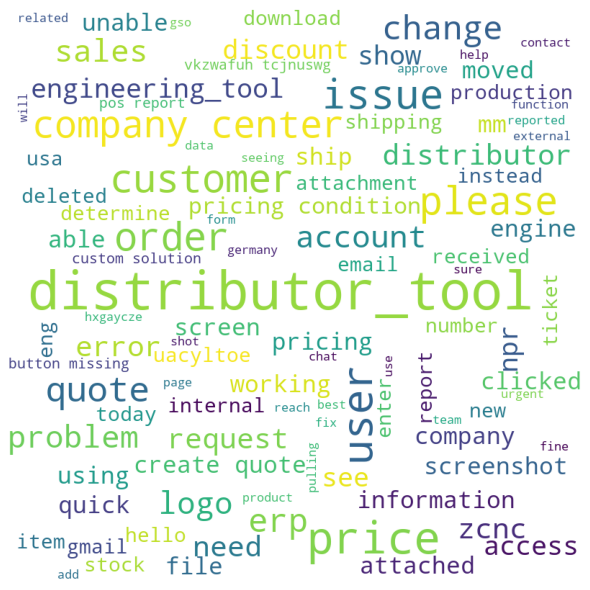



Assigment Group :  22
Value Match GRP_22
WordCloud Chart For: GRP_22


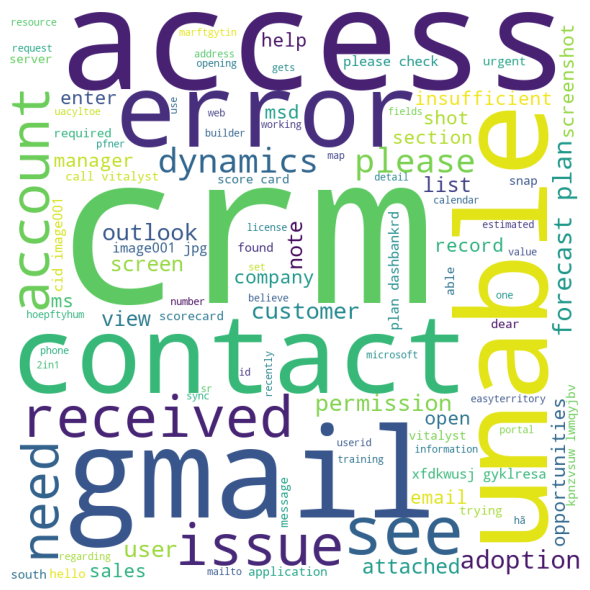



Assigment Group :  23
Value Match GRP_23
WordCloud Chart For: GRP_23


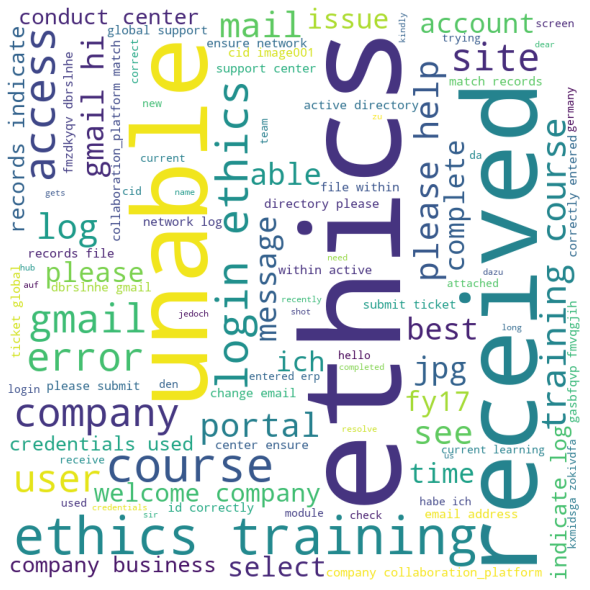



Assigment Group :  24
Value Match GRP_24
WordCloud Chart For: GRP_24


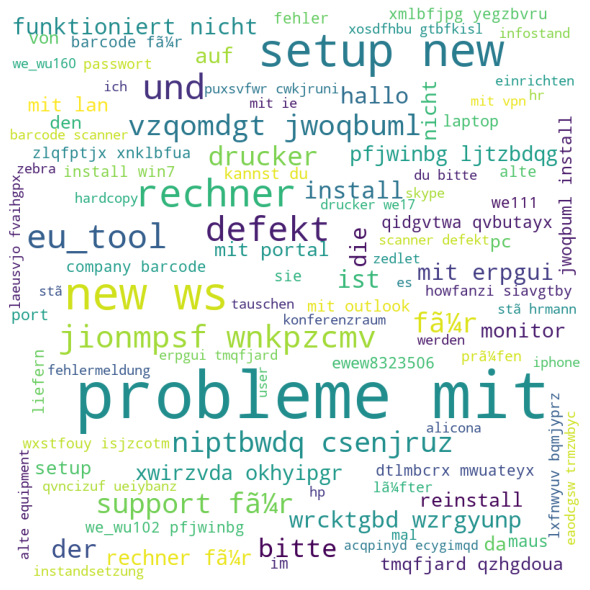



Assigment Group :  25
Value Match GRP_25
WordCloud Chart For: GRP_25


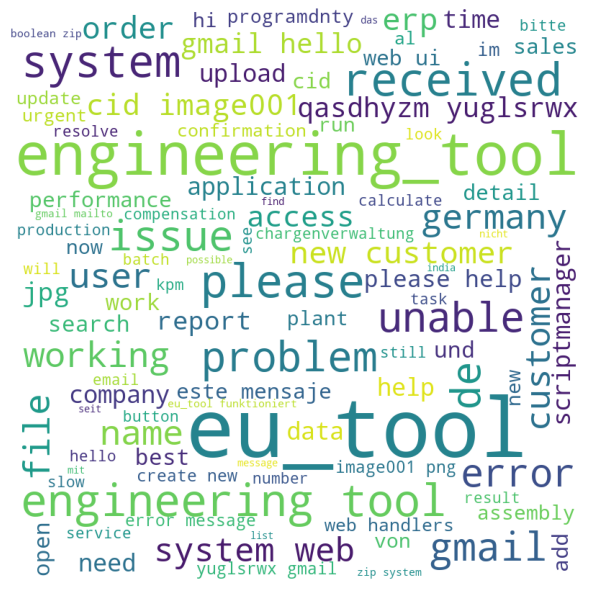



Assigment Group :  26
Value Match GRP_26
WordCloud Chart For: GRP_26


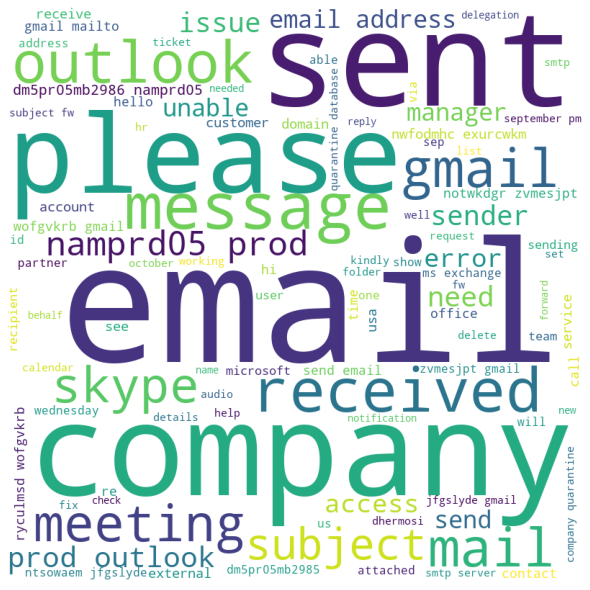



Assigment Group :  27
Value Match GRP_27
WordCloud Chart For: GRP_27


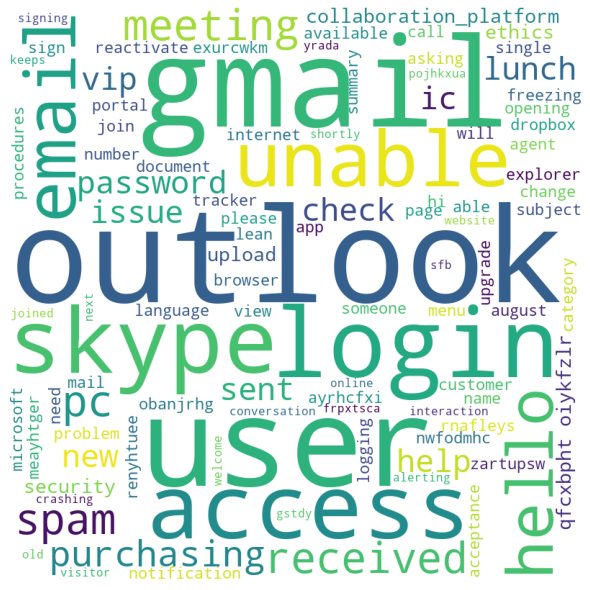



Assigment Group :  28
Value Match GRP_28
WordCloud Chart For: GRP_28


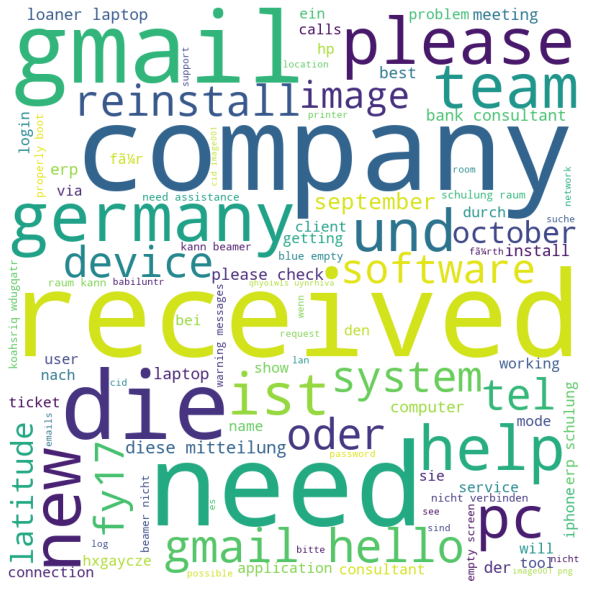



Assigment Group :  29
Value Match GRP_29
WordCloud Chart For: GRP_29


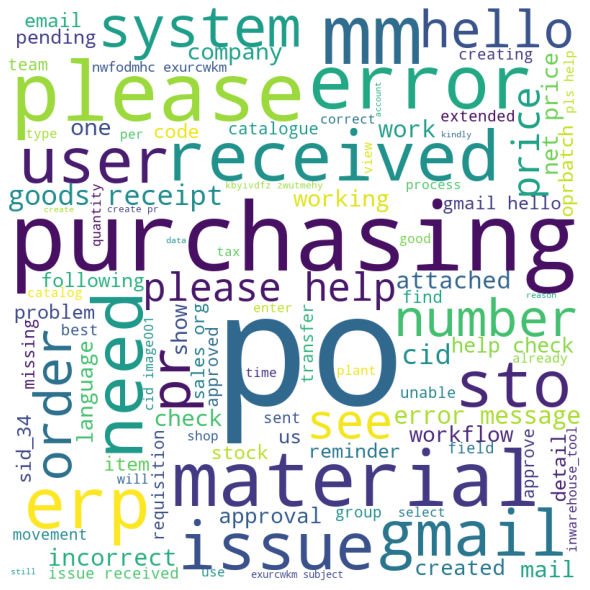



Assigment Group :  30
Value Match GRP_30
WordCloud Chart For: GRP_30


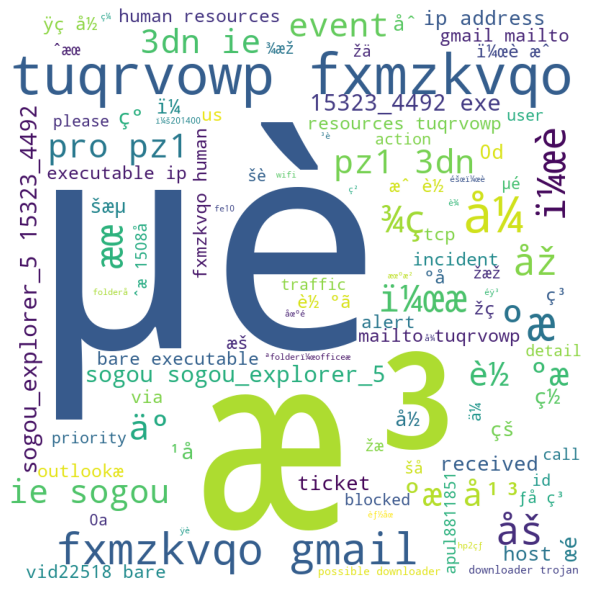



Assigment Group :  31
Value Match GRP_31
WordCloud Chart For: GRP_31


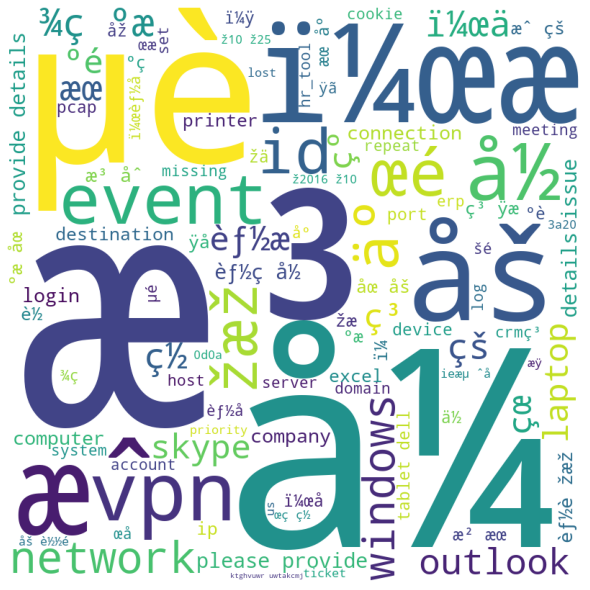



Assigment Group :  32
Value Match GRP_32
WordCloud Chart For: GRP_32


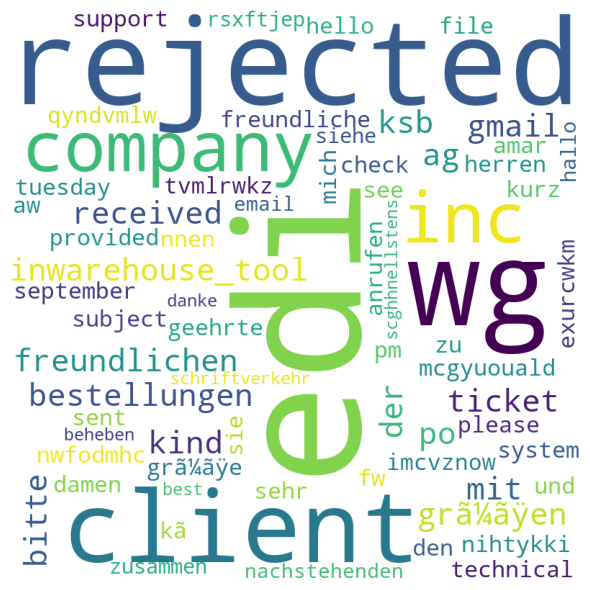



Assigment Group :  33
Value Match GRP_33
WordCloud Chart For: GRP_33


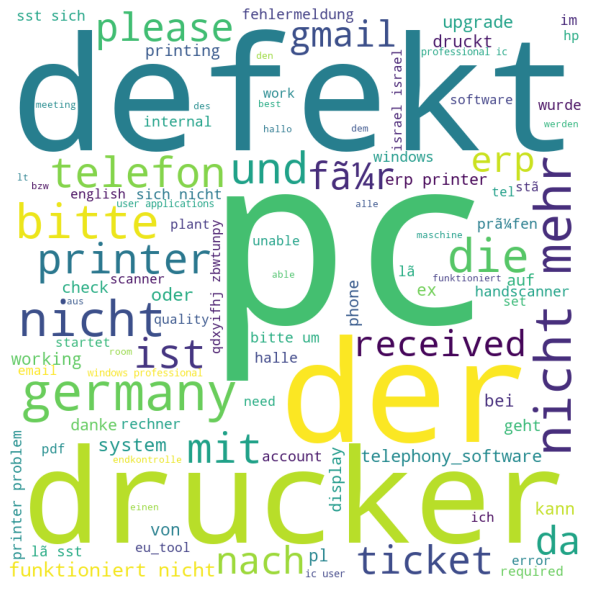



Assigment Group :  34
Value Match GRP_34
WordCloud Chart For: GRP_34


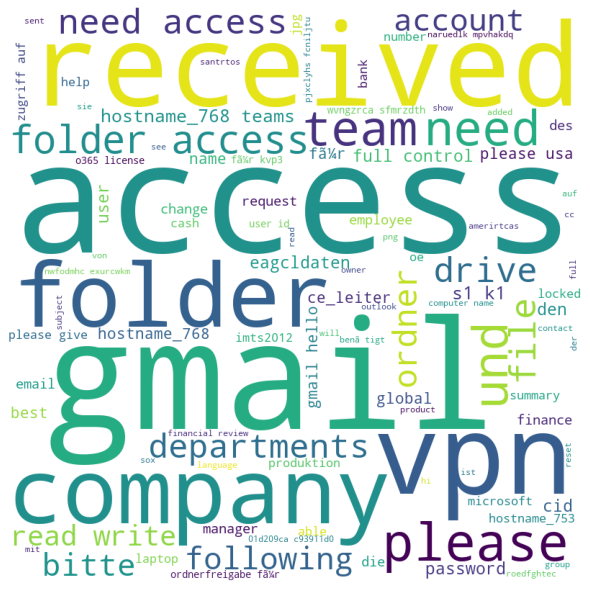



Assigment Group :  35
Value Match GRP_35
WordCloud Chart For: GRP_35


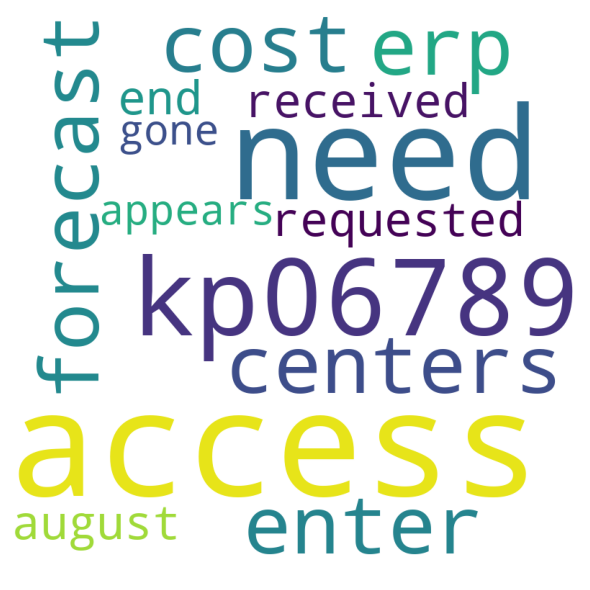



Assigment Group :  36
Value Match GRP_36
WordCloud Chart For: GRP_36


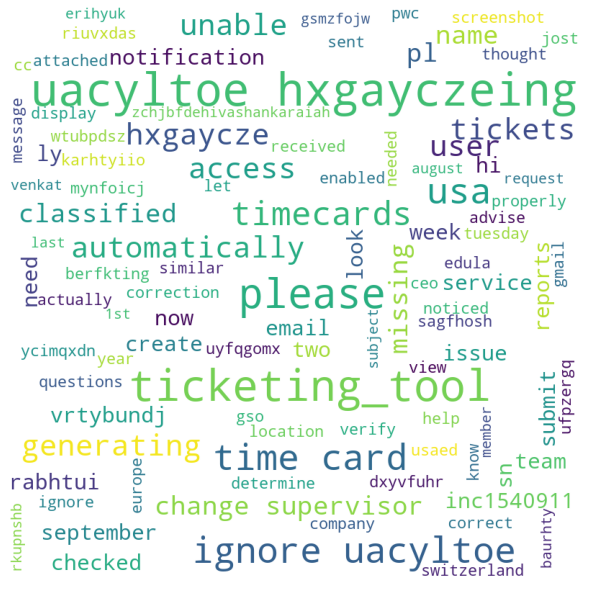



Assigment Group :  37
Value Match GRP_37
WordCloud Chart For: GRP_37


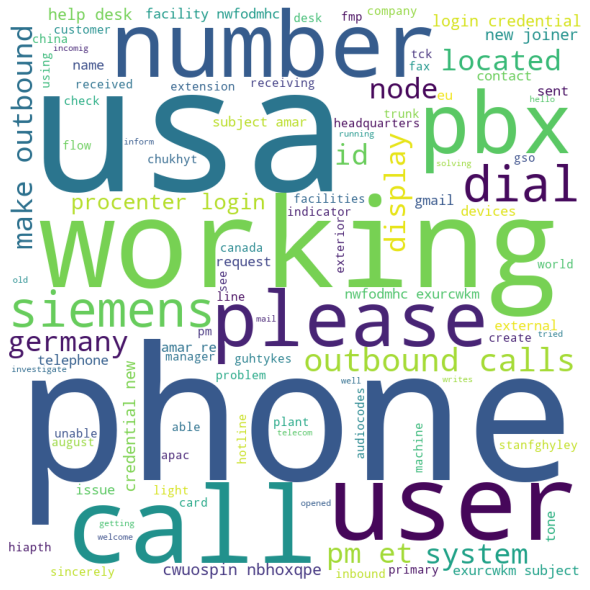



Assigment Group :  38
Value Match GRP_38
WordCloud Chart For: GRP_38


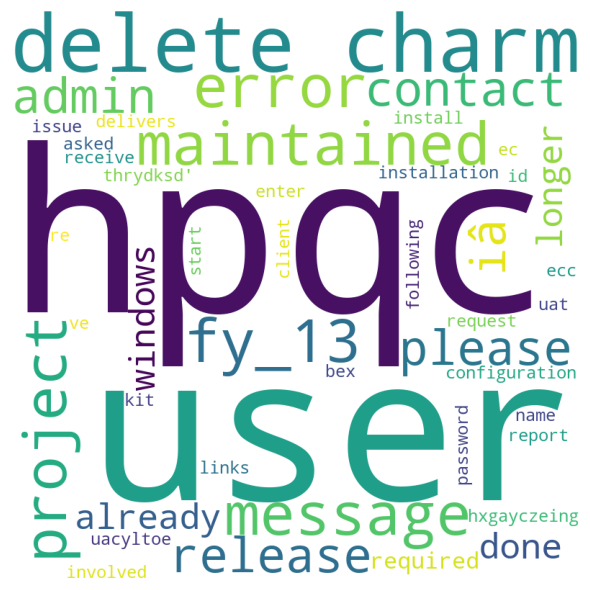



Assigment Group :  39
Value Match GRP_39
WordCloud Chart For: GRP_39


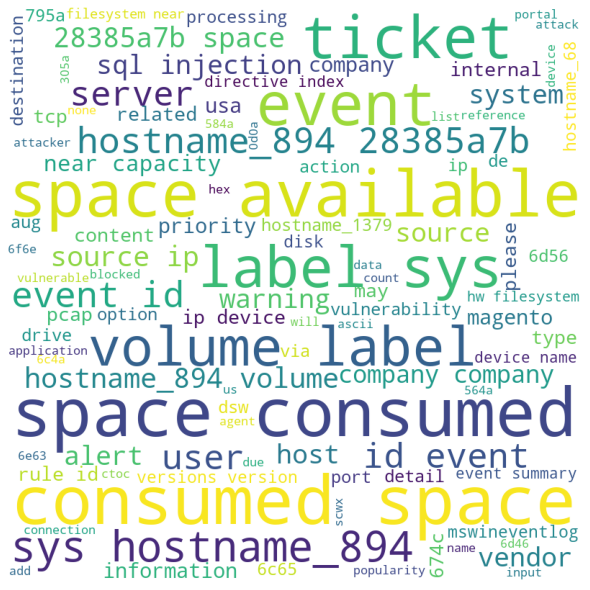



Assigment Group :  40
Value Match GRP_40
WordCloud Chart For: GRP_40


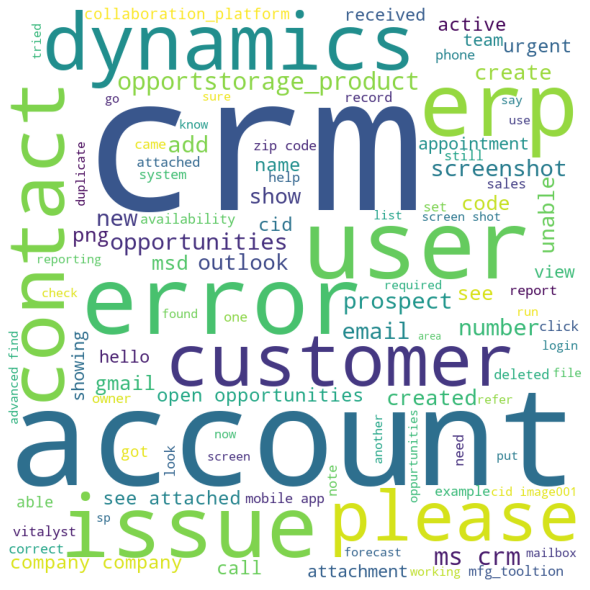



Assigment Group :  41
Value Match GRP_41
WordCloud Chart For: GRP_41


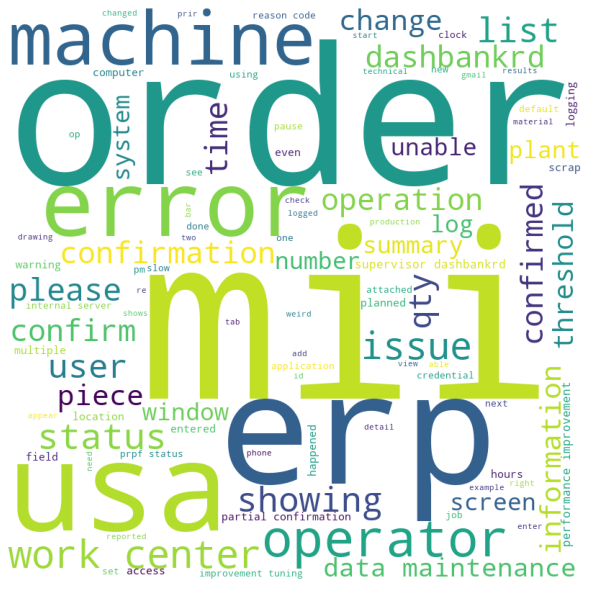



Assigment Group :  42
Value Match GRP_42
WordCloud Chart For: GRP_42


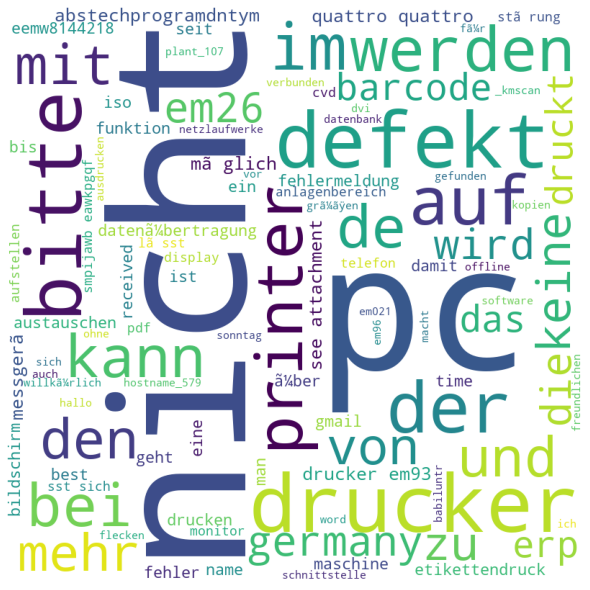



Assigment Group :  43
Value Match GRP_43
WordCloud Chart For: GRP_43


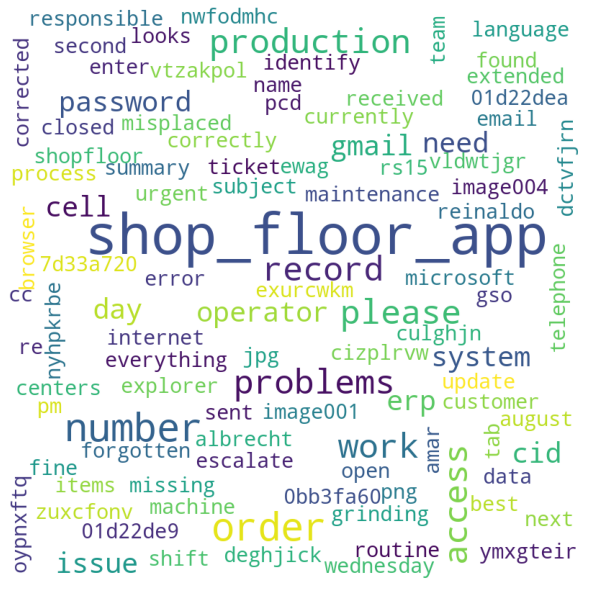



Assigment Group :  44
Value Match GRP_44
WordCloud Chart For: GRP_44


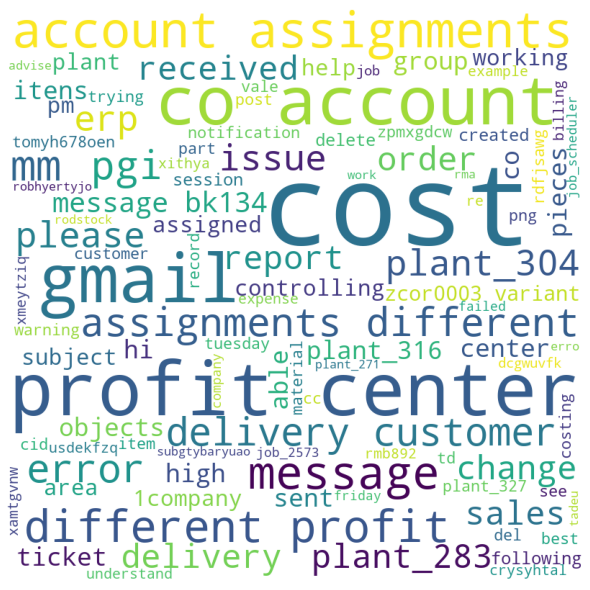



Assigment Group :  45
Value Match GRP_45
WordCloud Chart For: GRP_45


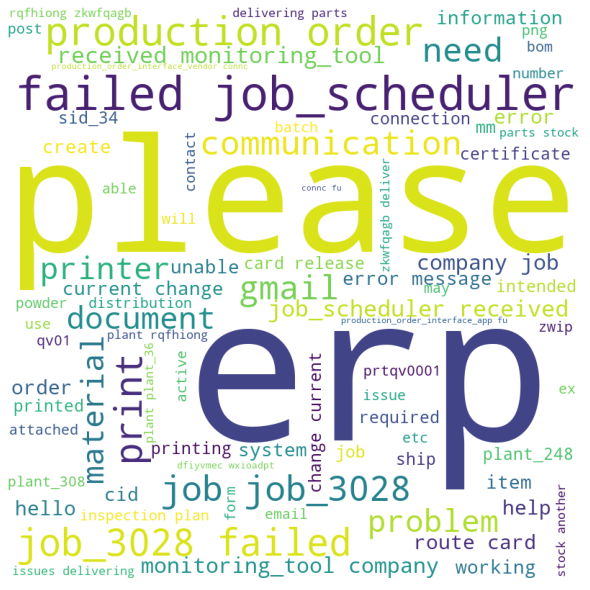



Assigment Group :  46
Value Match GRP_46
WordCloud Chart For: GRP_46


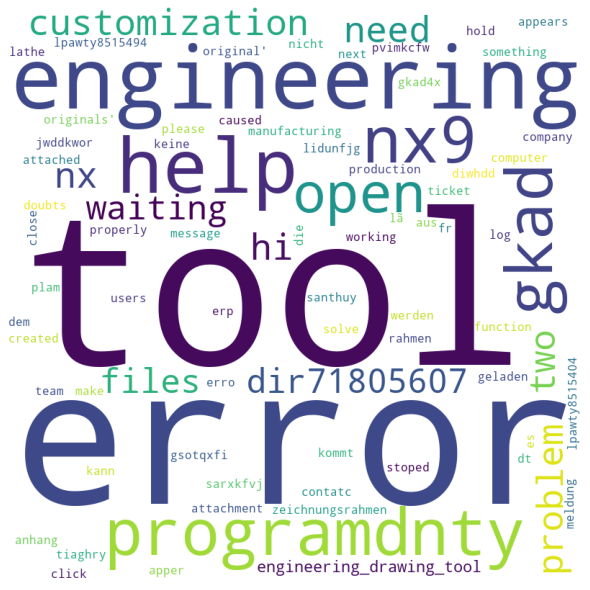



Assigment Group :  47
Value Match GRP_47
WordCloud Chart For: GRP_47


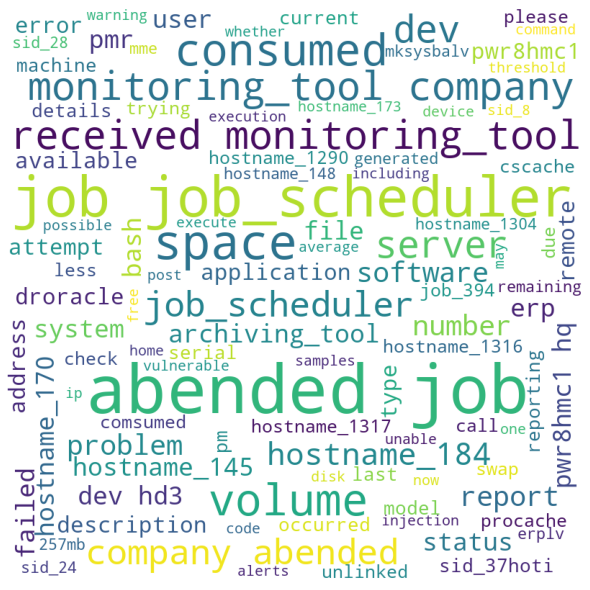



Assigment Group :  48
Value Match GRP_48
WordCloud Chart For: GRP_48


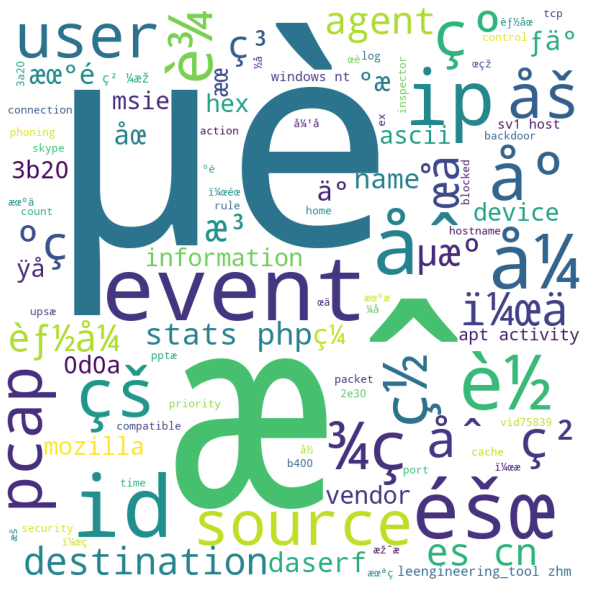



Assigment Group :  49
Value Match GRP_49
WordCloud Chart For: GRP_49


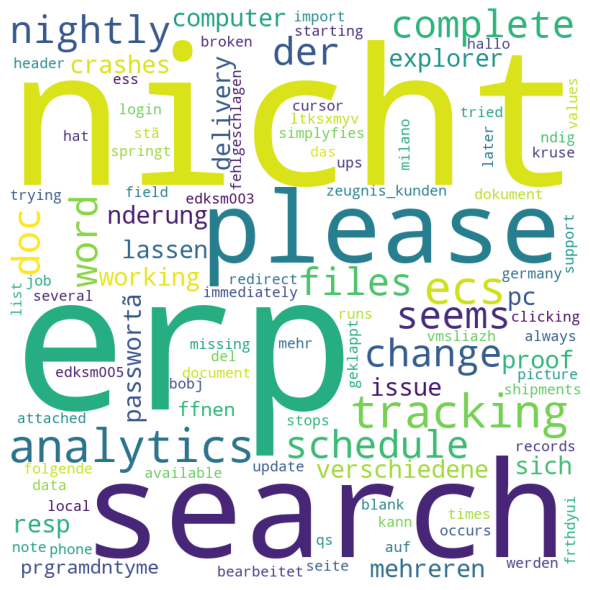



Assigment Group :  50
Value Match GRP_50
WordCloud Chart For: GRP_50


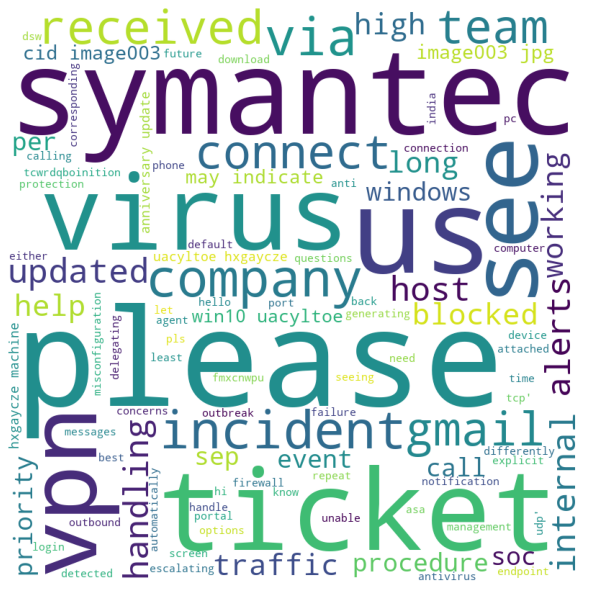



Assigment Group :  51
Value Match GRP_51
WordCloud Chart For: GRP_51


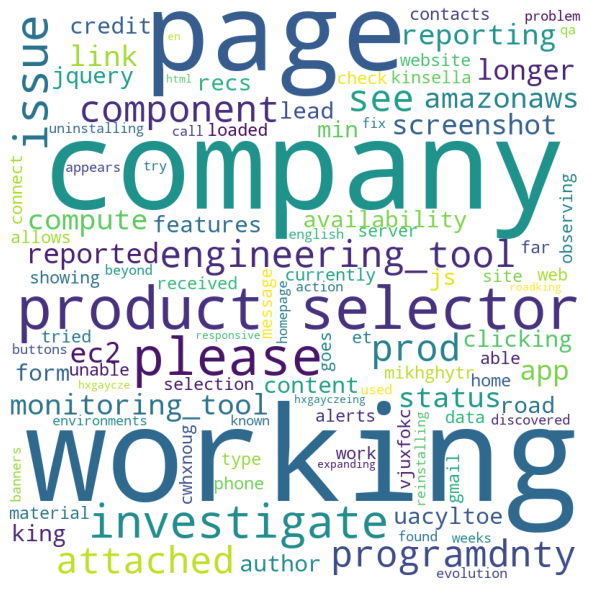



Assigment Group :  52
Value Match GRP_52
WordCloud Chart For: GRP_52


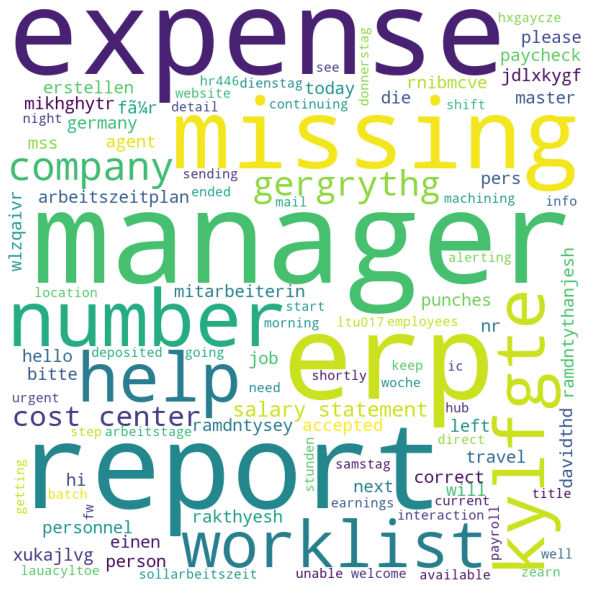



Assigment Group :  53
Value Match GRP_53
WordCloud Chart For: GRP_53


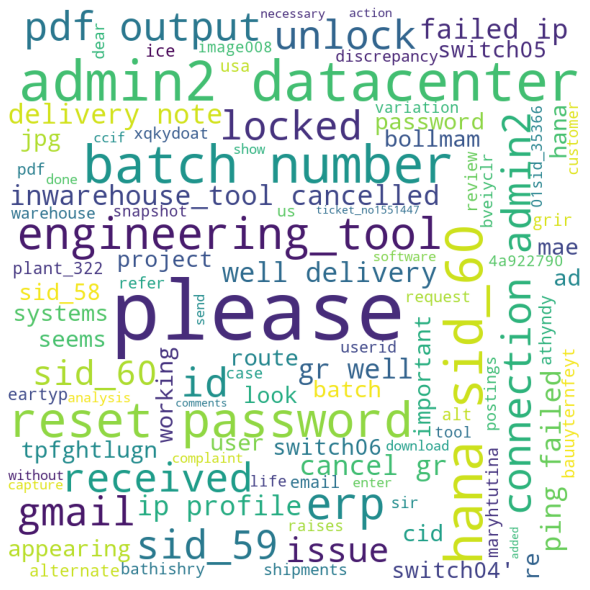



Assigment Group :  54
Value Match GRP_54
WordCloud Chart For: GRP_54


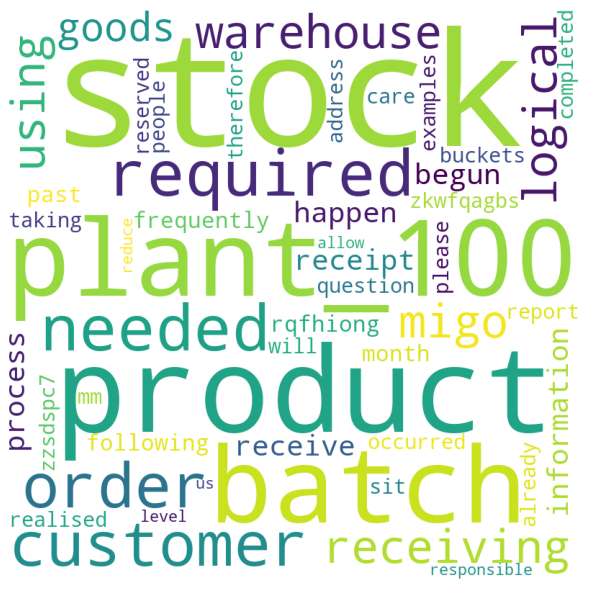



Assigment Group :  55
Value Match GRP_55
WordCloud Chart For: GRP_55


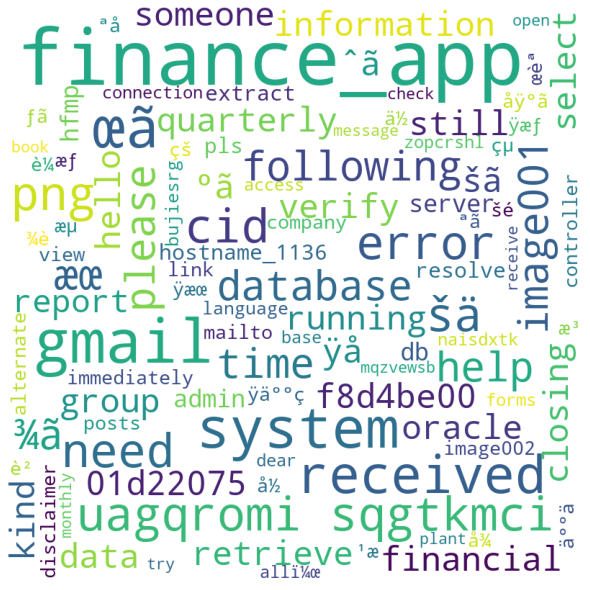



Assigment Group :  56
Value Match GRP_56
WordCloud Chart For: GRP_56


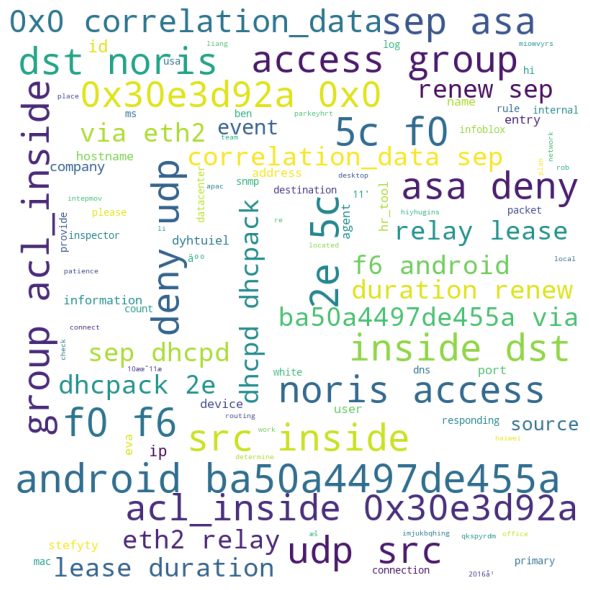



Assigment Group :  57
Value Match GRP_57
WordCloud Chart For: GRP_57


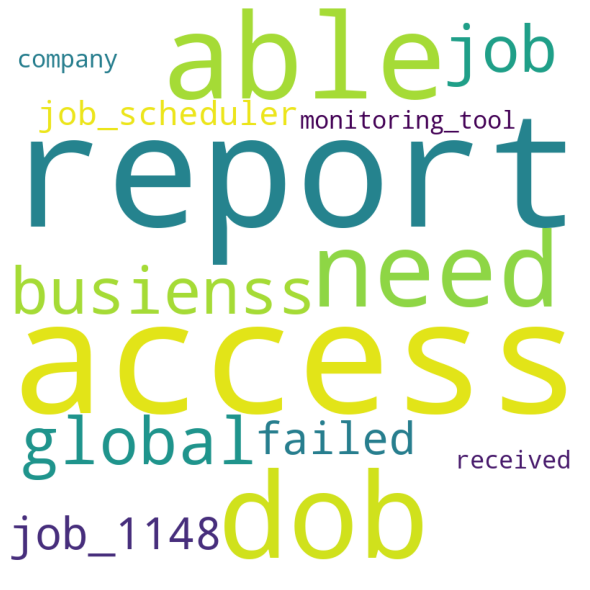



Assigment Group :  58
Value Match GRP_58
WordCloud Chart For: GRP_58


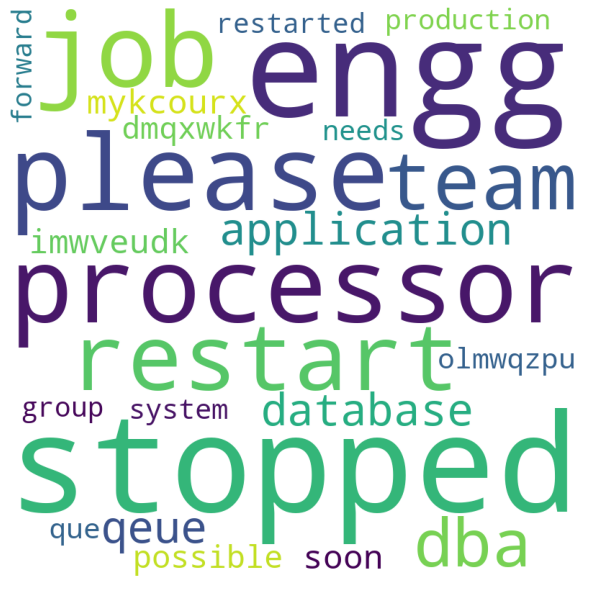



Assigment Group :  59
Value Match GRP_59
WordCloud Chart For: GRP_59


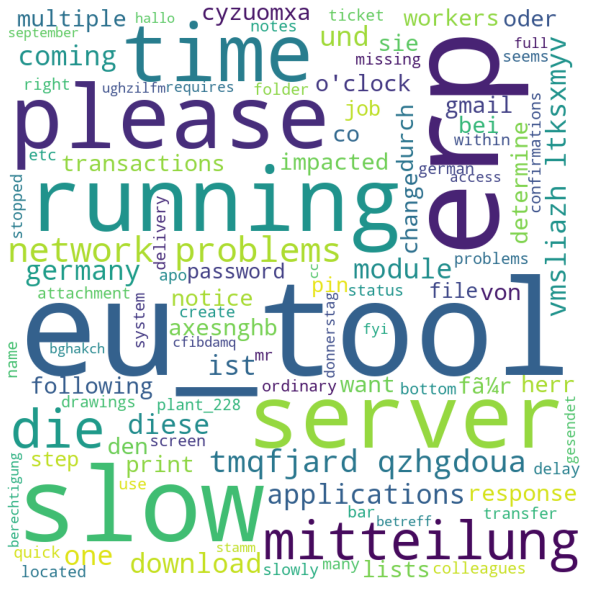



Assigment Group :  60
Value Match GRP_60
WordCloud Chart For: GRP_60


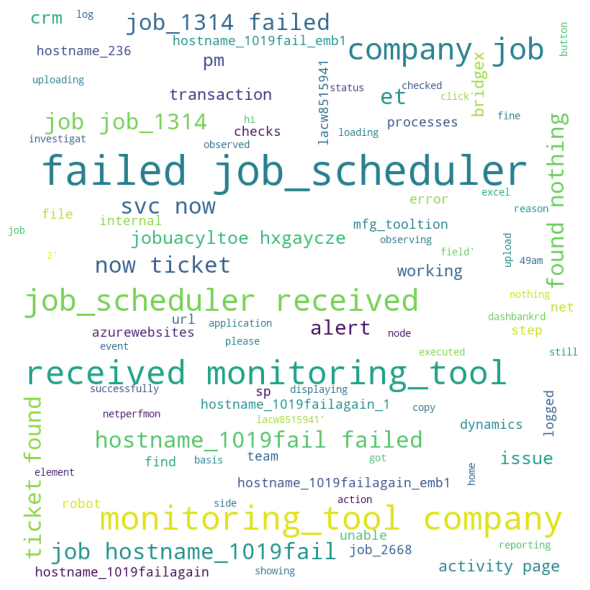



Assigment Group :  61
Value Match GRP_61
WordCloud Chart For: GRP_61


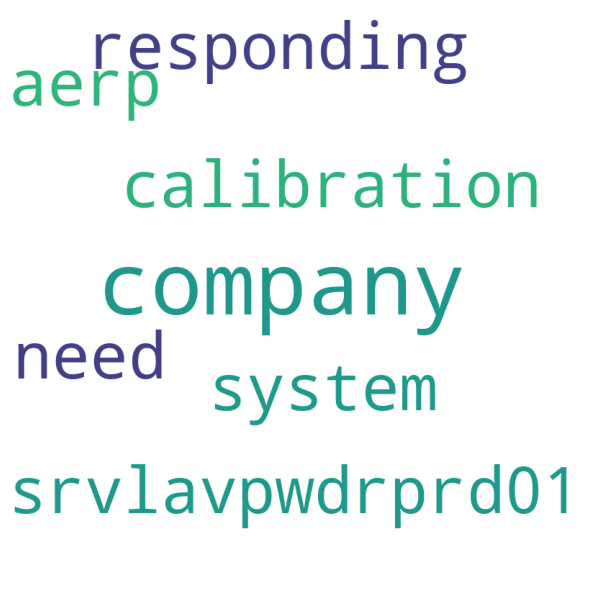



Assigment Group :  62
Value Match GRP_62
WordCloud Chart For: GRP_62


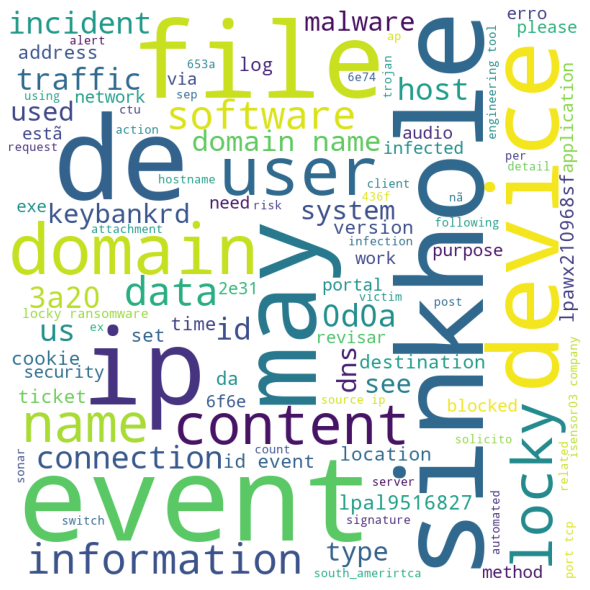



Assigment Group :  63
Value Match GRP_63
WordCloud Chart For: GRP_63


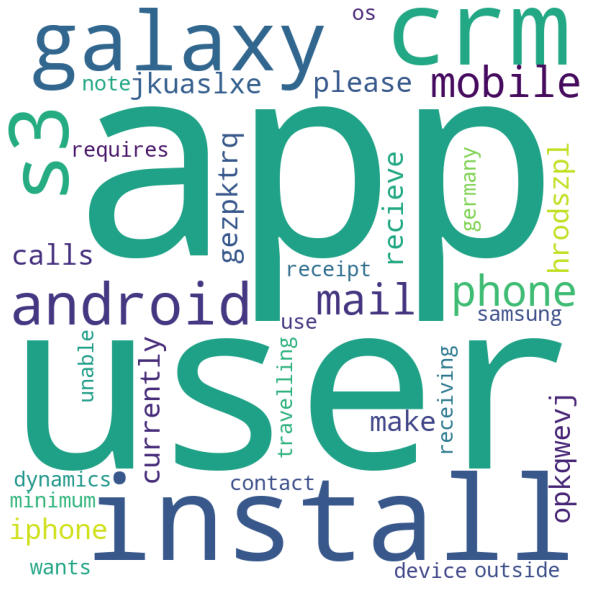



Assigment Group :  64
Value Match GRP_64
WordCloud Chart For: GRP_64


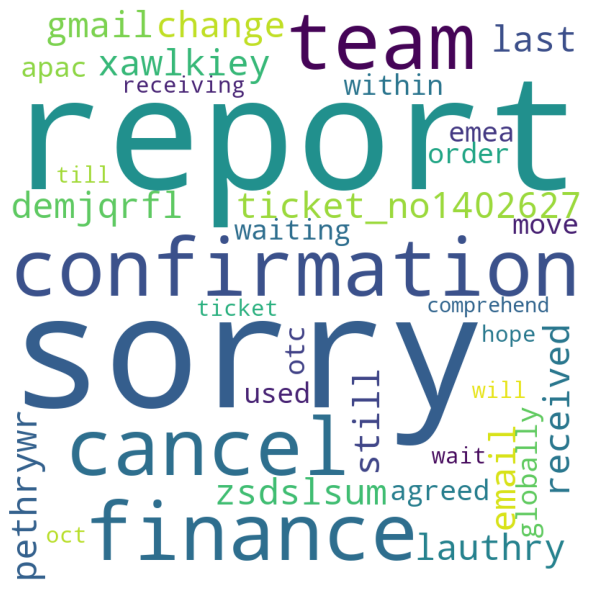



Assigment Group :  65
Value Match GRP_65
WordCloud Chart For: GRP_65


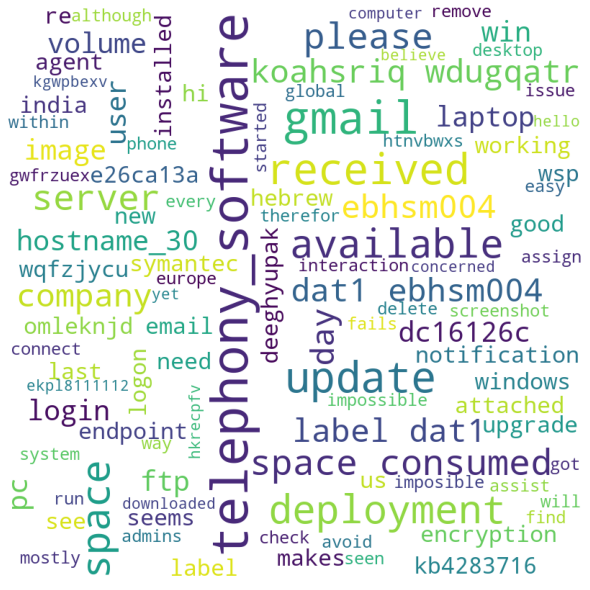



Assigment Group :  66
Value Match GRP_66
WordCloud Chart For: GRP_66


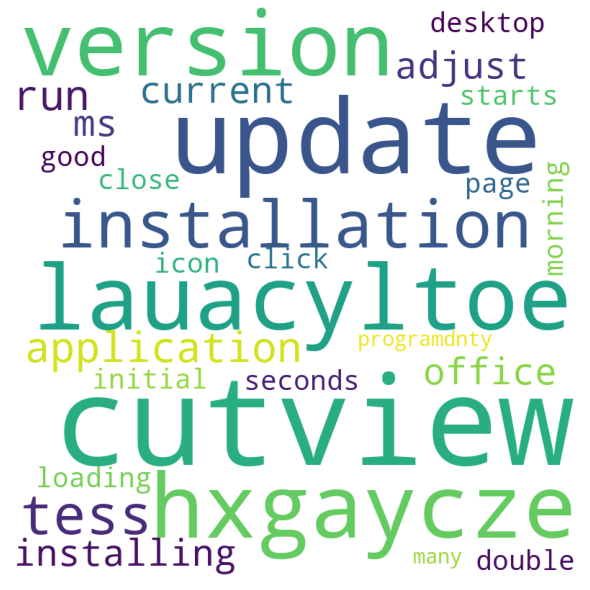



Assigment Group :  67
Value Match GRP_67
WordCloud Chart For: GRP_67


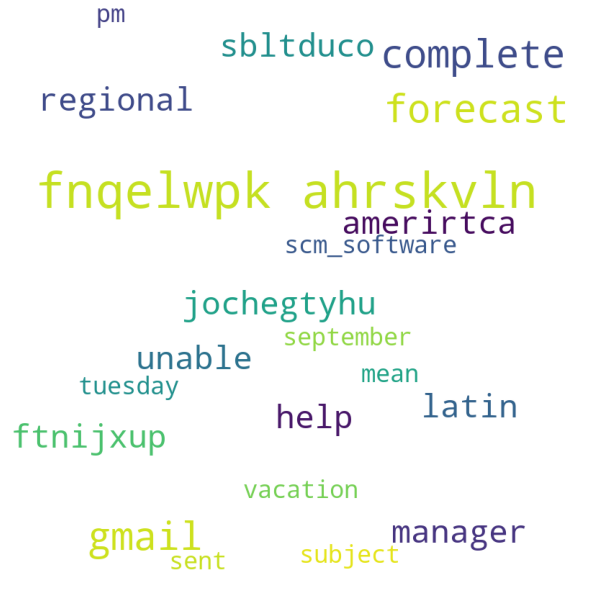



Assigment Group :  68
Value Match GRP_68
WordCloud Chart For: GRP_68


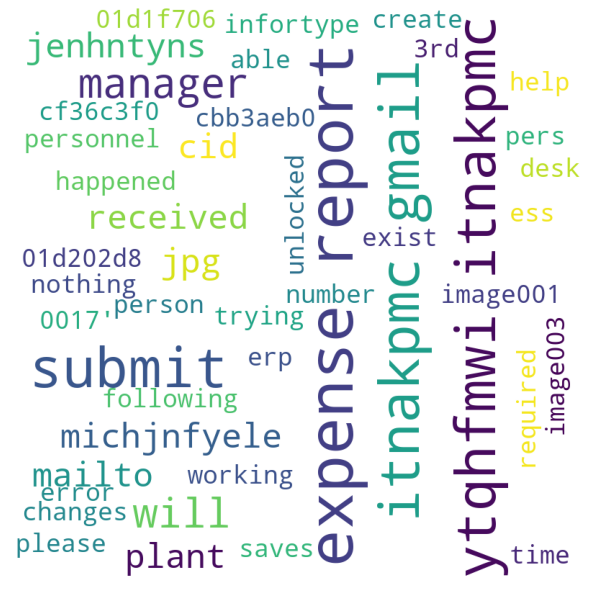



Assigment Group :  69
Value Match GRP_69
WordCloud Chart For: GRP_69


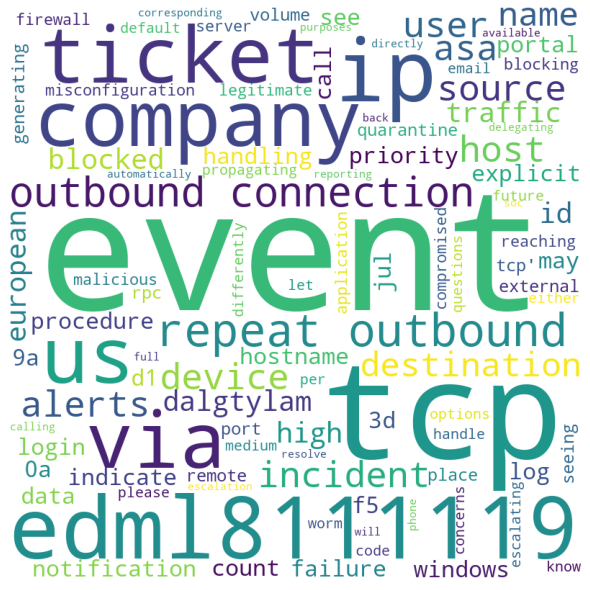



Assigment Group :  70
Value Match GRP_70
WordCloud Chart For: GRP_70


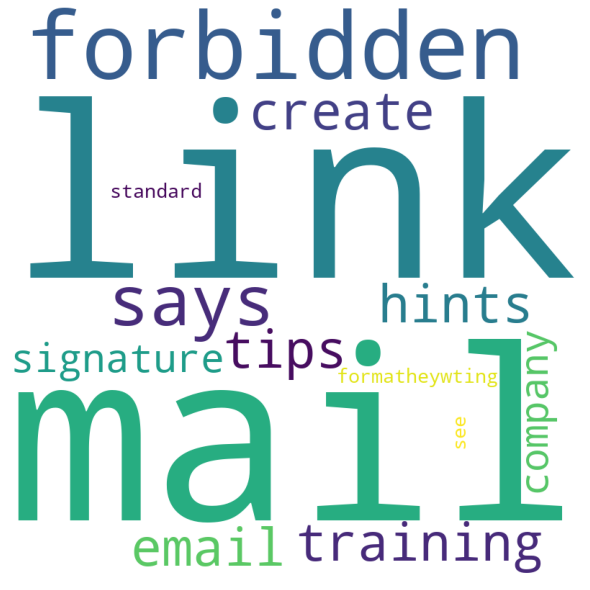



Assigment Group :  71
Value Match GRP_71
WordCloud Chart For: GRP_71


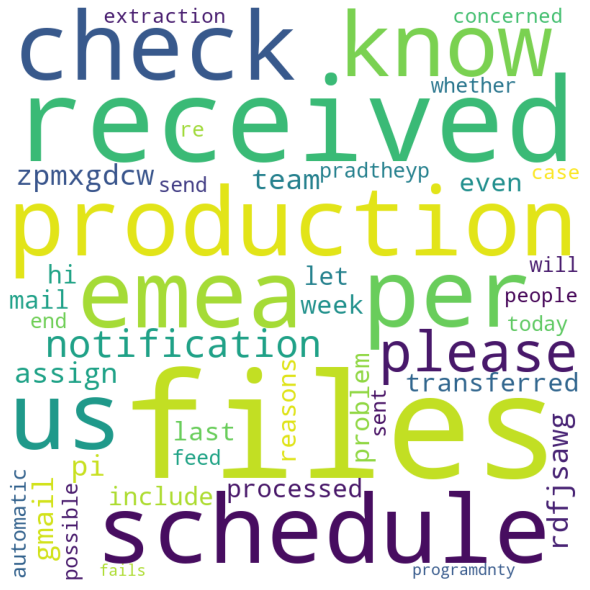



Assigment Group :  72
Value Match GRP_72
WordCloud Chart For: GRP_72


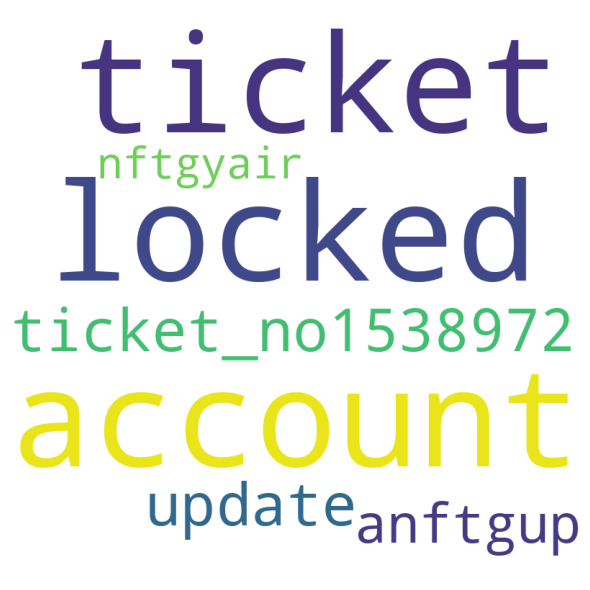



Assigment Group :  73
Value Match GRP_73
WordCloud Chart For: GRP_73


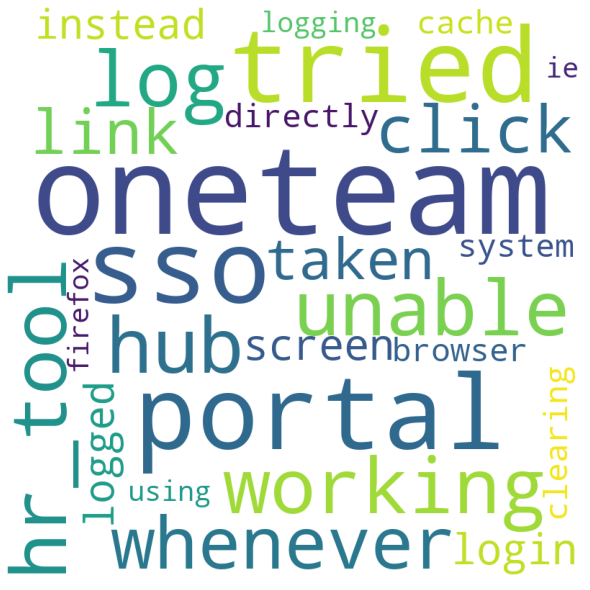

In [124]:
for i in range(incidents_data['Assignment group'].nunique()):
  group_num = str(i)
  group = 'GRP_' + group_num
  print("Assigment Group : ", group_num)
  wordCloudForGroup(incidents_data,"Ticket_Description",group)

## 3.5.7 N-gram Analysis 

N-gram, Unigram and Bigram analysis
N grams are used to describe number of words as obersvations as unigram means singly-worded, bigram means 2-worded phrase, and trigram means 3-worded phrase.

Will do this analysis before and after the removal of stop-words to look for any unexpected changes

In [11]:
def get_top_n_words(text, n=None,stopwords=None):
    vec = CountVectorizer(ngram_range=(1,1),stop_words=stopwords).fit(text)
    bag_of_words = vec.transform(text)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
print("Top 20 Unigrams in the Ticket Description feature before removal of stopwords")
unigram_words = get_top_n_words(incidents_data['Ticket_Description'], 20)
for word, freq in unigram_words:
    print(word, freq)
incidents_df = pd.DataFrame(unigram_words, columns = ['Ticket_Description' , 'count'])

Top 20 Unigrams in the Ticket Description feature before removal of stopwords
to 8756
the 7057
in 5181
com 3804
from 3590
is 3558
on 2967
not 2944
company 2773
and 2769
for 2648
at 2504
received 2387
no 2377
00 2258
2016 2247
gmail 2205
please 2180
password 2055
erp 2055


Now lets visualize the Top 20 unigrams



In [12]:
incidents_df.groupby('Ticket_Description').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 unigrams before removal of stop words')

In [13]:
def get_top_n_bigram(text, n=None,stopwords=None):
    vec = CountVectorizer(ngram_range=(2, 2),stop_words=stopwords).fit(text)
    bag_of_words = vec.transform(text)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
print("Top 20 bigrams in the Ticket Description feature before removal of stopwords")
bigram_words = get_top_n_bigram(incidents_data['Ticket_Description'], 20)
for word, freq in bigram_words:
    print(word, freq)
incidents_df1 = pd.DataFrame(bigram_words, columns = ['Ticket_Description' , 'count'])

Top 20 bigrams in the Ticket Description feature before removal of stopwords
received from 2256
gmail com 2205
in job_scheduler 1920
yes no 1744
failed in 1615
job_scheduler at 1613
no na 1570
unable to 1483
company com 1429
from monitoring_tool 961
monitoring_tool company 961
00 received 803
com job 785
password reset 778
to the 717
is not 660
at 09 633
at 10 600
at 08 526
not working 512


Now lets visualize top 20 bigrams

In [15]:
incidents_df1.groupby('Ticket_Description').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams before removal of stop words')

As we can see that there are few english stopwords in the Ticket_Description feature other than the default ones provided by NLTK library, lets extend the default list and then remove them from the Ticket_Description feature and visualize unigrams and bigrams post that.

In [30]:
stopwords = stopwords.union({'yes','na','hi',
                              'hello','no',
                              'regards','thanks',
                              'from','greeting',
                              'reply',
                              'will','please',
                              'see'})

In [17]:
#StopWords removal
incidents_data['Ticket_Description'] = incidents_data['Ticket_Description'].apply(lambda x: ' '.join([word for word in x.split() if word not in stopwords]))


In [20]:
print("Top 20 unigrams in the Ticket Description feature after removal of stopwords")
unigram_words = get_top_n_words(incidents_data['Ticket_Description'], 20,stopwords=stopwords)
for word, freq in unigram_words:
    print(word, freq)
incidents_df = pd.DataFrame(unigram_words, columns = ['Ticket_Description' , 'count'])

Top 20 unigrams in the Ticket Description feature after removal of stopwords
com 3804
company 2773
received 2387
00 2258
2016 2247
gmail 2205
password 2055
erp 2055
job 1984
job_scheduler 1928
failed 1735
10 1588
reset 1530
unable 1498
user 1469
access 1425
issue 1310
account 1211
09 1065
ticket 1017


In [19]:
incidents_df.groupby('Ticket_Description').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 unigrams after removing stopwords')

In [21]:
bigram_words = get_top_n_bigram(incidents_data['Ticket_Description'], 20,stopwords=stopwords)
for word, freq in bigram_words:
    print(word, freq)
incidents_df1 = pd.DataFrame(bigram_words, columns = ['Ticket_Description' , 'count'])

gmail com 2205
failed job_scheduler 1614
company com 1429
received monitoring_tool 961
monitoring_tool company 961
00 received 803
com job 786
password reset 784
job_scheduler 09 623
job_scheduler 10 576
erp sid_34 497
backup circuit 441
account locked 398
job_scheduler 08 372
00 00 321
cid image001 307
reset password 302
job job_scheduler 300
abended job 298
ticket update 295


In [22]:
incidents_df1.groupby('Ticket_Description').sum()['count'].sort_values(ascending=False).iplot(
    kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams after removing stop words')

# 3.6 DATA PREPROCESSING 

### 3.6.1 Fix encoding

In [18]:
def fix_mojibake_text(dataframe,description_column):
  fixed_text = []
  for column in dataframe[[description_column]]:
    # Select column contents by column name using [] operator
    Text = dataframe[column]
    print('Text : ', len(Text))
    for i in range(len(Text)) :
      #print(i)
      fix_text_i = ftfy.fix_text(Text.values[i])
      fixed_text.append(fix_text_i)
    return fixed_text

In [19]:
incidents_data['Fixed_text'] = fix_mojibake_text(incidents_data, 'Ticket_Description')

Text :  8500


In [20]:
incidents_data.head()

,Short description,Description,Caller,Assignment group,Ticket_Description,Fixed_text
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0,login issue -verified user details.(employee# ...,login issue -verified user details.(employee# ...
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0,outlook \r\n\r\nreceived from: hmjdrvpb.komuay...,outlook \n\nreceived from: hmjdrvpb.komuaywn@g...
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0,cant log in to vpn \r\n\r\nreceived from: eylq...,cant log in to vpn \n\nreceived from: eylqgodm...
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr_tool page unable to access...,unable to access hr_tool page unable to access...
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error,skype error skype error


Lets verify mojibake text cleaning by taking 1 sample

In [26]:
incidents_data[incidents_data['Assignment group']=='GRP_24'].Ticket_Description

222     support fÃ¼r fa.gstry \arexjftu ohxdwngl suppo...
223     probleme mit bluescreen . hallo , es ist erneu...
255     probleme mit laufwerk z: \laeusvjo fvaihgpx pr...
302     EU_tool ist sehr langsadgtym \ywqgrbnx jwnsyzb...
304     alte eq abholen \wrcktgbd wzrgyunp alte eq abh...
                              ...                        
8413    pobleme mit we_combi \jionmpsf wnkpzcmv poblem...
8414    langsamer rechner \Ã¼berprÃ¼fung \niptbwdq cse...
8416    setup new ws \kebogxzp difnjlkp setup new ws \...
8417    bluetooth keybankrd defekt \dardabthyr bluetoo...
8419    probleme mit bildschirmschoner \ we91 \jionmps...
Name: Ticket_Description, Length: 289, dtype: object

In [21]:
incidents_data[incidents_data['Assignment group']=='GRP_24'].Fixed_text

222     support für fa.gstry \arexjftu ohxdwngl suppor...
223     probleme mit bluescreen . hallo ,\n\nes ist er...
255     probleme mit laufwerk z: \laeusvjo fvaihgpx pr...
302     EU_tool ist sehr langsadgtym \ywqgrbnx jwnsyzb...
304     alte eq abholen \wrcktgbd wzrgyunp alte eq abh...
                              ...                        
8413    pobleme mit we_combi \jionmpsf wnkpzcmv poblem...
8414    langsamer rechner \überprüfung \niptbwdq csenj...
8416    setup new ws \kebogxzp difnjlkp  setup new ws ...
8417    bluetooth keybankrd defekt \dardabthyr bluetoo...
8419    probleme mit bildschirmschoner \ we91 \jionmps...
Name: Fixed_text, Length: 289, dtype: object

From above we can see that the Mojibake texts are now fixed. Now let's see which all languages are there is dataframe.

For this we will use langdetect library

### 3.6.2 Detecting language 

In [22]:
def language_detector(dataframe):
  try:
    language = detect(dataframe)
    return language
  except:
    return 'Language could not be detected'

In [23]:
incidents_data['Language'] = incidents_data['Fixed_text'].apply(language_detector)

In [24]:
print("Unique langugage counts across")
incidents_data['Language'].value_counts()

Unique langugage counts across


en       7091
de        415
af        277
it        123
fr        111
no         64
nl         63
zh-cn      50
es         48
sv         46
ca         39
da         27
pl         27
pt         17
ko         16
ro         14
sq         11
cy         10
tl         10
et          9
hr          8
fi          5
vi          4
id          4
sl          4
so          2
lt          2
cs          1
lv          1
tr          1
Name: Language, dtype: int64

Above we see that most of the descriptions are in English langauge followed by German

### 3.6.3 Translation

In [ ]:
def translate_to_english(dataframe,description_column, language_column,language):
  english_text = []

  for column in dataframe[[description_column, language_column]]:
    # Select column contents by column name using [] operator
    if column == description_column:
      Text = dataframe[column]
      #print('Text : ', Text[0])

    if column == language_column:
      Lang = dataframe[column]
      #print('Language : ' , Lang[0])
  

  for i in range(len(Text)) :
    print(i)
    try:
      print('Langauge : ' , Lang[i])
      Text_language = Lang[i]
      if Text_language == 'en':
        print('Translation not needed')
        english_text.append(Text[i])
        with open('/content/drive/MyDrive/Colab Notebooks/english text.pkl', 'wb') as f:
          pickle.dump(english_text, f)
          print('File pickled')
      else:            
          print('Original Text: ', Text[i])
          translated = ts.alibaba(Text[i], professional_field='general')
          print('Translation done', translated)
          english_text.append(translated)
          print('Translation appended')
          with open('/content/drive/MyDrive/Colab Notebooks/english text.pkl', 'wb') as f:
            pickle.dump(english_text, f)
            print('File pickled')
    except Exception as e:
      print('Exception occured : ', e)
      for j in range(i,len(Text)):
        english_text.append(Text.values[j])
      with open('/content/drive/MyDrive/Colab Notebooks/english text.pkl', 'wb') as f:
        pickle.dump(english_text, f)
        print('File pickled')
      return english_text
      
  with open('/content/drive/MyDrive/Colab Notebooks/english text.pkl', 'wb') as f:
        pickle.dump(english_text, f)
        print('File pickled')
  return english_text
    
    

Above function was called in chunks of Data and file is pickled for future use and then final set was prepared using the below approach:-

#final_translated_texts = []

#final_translated_texts.extend(mynewlist1)
#final_translated_texts.extend(mynewlist2)
#final_translated_texts.extend(mynewlist3)
#final_translated_texts.extend(mynewlist4)
#final_translated_texts.extend(mynewlist5)
#final_translated_texts.extend(mynewlist6)

In [25]:
with open('/content/drive/MyDrive/Capstone/Final_English_Texts.pkl', 'rb') as f:
  final_translated_texts = pickle.load(f)

In [26]:
incidents_data['Translated_text'] = final_translated_texts

In [27]:
print(len(final_translated_texts))

8500


After translations we have about 95% data which is translated correctly. There's still 5% data which are Common Nouns, etc and are left untranslated.

Lets verify the translation by taking 1 sample text


In [43]:
print("Before translation :", incidents_data['Fixed_text'][8499])

Before translation : mehreren pc`s lassen sich verschiedene prgramdntyme nicht öffnen. mehreren pc`s lassen sich verschiedene prgramdntyme nicht öffnen. bereich cnc.


In [44]:
print("After translation :", incidents_data['Translated_text'][8499])

After translation : At several pc's can different prgramdntyme not open. At several pc's can different prgramdntyme not open. Area CNC.


# 3.7 DATA CLEANING
1. Convert the text to lowercase
2. Removing punctuation marks and other special characters
3. Removing numbers as converting them into corresponding words will result into dominance otherwise
4. Removing blank spaces, horizontal tab spaces, new line breaks with single space.
5. Removing stop words, parse terms and other particular words.
6. Removing email addresses as it will not add any significant value into the expected analysis.

In [31]:
EMAIL_PATTERN = r"([\w.+-]+@[a-z\d-]+\.[a-z\d.-]+)"
PUNCT_PATTERN = r"[,|@|\|?|\\|$&*|%|\r|\n|.:|\s+|/|//|\\|/|\||-|<|>|;|(|)|=|+|#|-|\"|[-\]]|{|}]"
def clean_text(df, column_name=''):

   # Convert text to lowercase
  df[column_name] = df[column_name].apply(lambda x: x.lower())

  # Strip unwanted spaces
  df[column_name] = df[column_name].apply(lambda x: x.strip())

  # Select only alphabets
  df[column_name] = df[column_name].apply(lambda x: re.sub('[^A-Za-z]+', ' ', x))

  
  # Remove email ids
  df[column_name] = df[column_name].apply(lambda x: re.sub(EMAIL_PATTERN, '', x, flags=re.IGNORECASE))
  
  df[column_name] = df[column_name].apply(lambda x: re.sub(PUNCT_PATTERN, " ", x, flags=re.MULTILINE))

  #Single-Double line spaces
  df[column_name] = df[column_name].apply(lambda x: re.sub(r'\s+', ' ', x))
  df[column_name] = df[column_name].apply(lambda x: re.sub(r' {2,}', " ", x, flags=re.MULTILINE))
  
  #Special character
  df[column_name] = df[column_name].apply(lambda x: x.replace('`',"'"))

  return df

In [32]:
incidents_data = clean_text(incidents_data,column_name='Translated_text')

In [33]:
incidents_data['Translated_text']

0       login issue verified user details employee man...
1       outlook received from hello team my meetings s...
2       cant log in to vpn received from hi i cannot l...
3       unable to access hr tool page unable to access...
4                                 skype error skype error
                              ...                        
8495    emails not coming in from zz mail received fro...
8496    telephony software issue telephony software issue
8497    vip windows password reset for tifpdchb pedxru...
8498    machine n o est funcionando i am unable to acc...
8499    at several pc s can different prgramdntyme not...
Name: Translated_text, Length: 8500, dtype: object

## 3.7.1 Removal of stopwords

In [34]:
incidents_data['cleaned_description'] = incidents_data['Translated_text'].apply(lambda x: " ".join(x for x in str(x).split() if x not in stopwords))
incidents_data['cleaned_description'].head()

0    login issue verified user details employee man...
1    outlook received team meetings skype meetings ...
2            cant log vpn received cannot log vpn best
3    unable access hr tool page unable access hr to...
4                              skype error skype error
Name: cleaned_description, dtype: object

Stemming and Lemmatization are Text Normalization (or sometimes called Word Normalization) techniques in the field of Natural Language Processing that are used to prepare text, words, and documents for further processing.

Stemming is the process of reducing inflection in words to their root forms such as mapping a group of words to the same stem even if the stem itself is not a valid word in the Language.

Lemmatization, unlike Stemming, reduces the inflected words properly ensuring that the root word belongs to the language. In Lemmatization root word is called Lemma.




## 3.7.2 Lemmatization


In [35]:
## Lemmatization
incidents_data['cleaned_description']= incidents_data['cleaned_description'].apply(lambda x: " ".join([Word(word).lemmatize() for word in str(x).split()]))
incidents_data['cleaned_description'].head()

0    login issue verified user detail employee mana...
1    outlook received team meeting skype meeting et...
2            cant log vpn received cannot log vpn best
3    unable access hr tool page unable access hr to...
4                              skype error skype error
Name: cleaned_description, dtype: object

In [36]:
incidents_data.head()

,Short description,Description,Caller,Assignment group,Ticket_Description,Fixed_text,Language,Translated_text,cleaned_description
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0,login issue -verified user details.(employee# ...,login issue -verified user details.(employee# ...,en,login issue verified user details employee man...,login issue verified user detail employee mana...
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0,outlook \r\n\r\nreceived from: hmjdrvpb.komuay...,outlook \n\nreceived from: hmjdrvpb.komuaywn@g...,en,outlook received from hello team my meetings s...,outlook received team meeting skype meeting et...
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0,cant log in to vpn \r\n\r\nreceived from: eylq...,cant log in to vpn \n\nreceived from: eylqgodm...,en,cant log in to vpn received from hi i cannot l...,cant log vpn received cannot log vpn best
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr_tool page unable to access...,unable to access hr_tool page unable to access...,en,unable to access hr tool page unable to access...,unable access hr tool page unable access hr to...
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error,skype error skype error,no,skype error skype error,skype error skype error


## 3.7.2 Tokenization

In [37]:
tokenizer = nltk.tokenize.RegexpTokenizer(r'\w+')
incidents_data['token_desc'] = incidents_data['cleaned_description'].apply(lambda x: tokenizer.tokenize(x))

In [38]:
incidents_data['token_desc'].head()

0    [login, issue, verified, user, detail, employe...
1    [outlook, received, team, meeting, skype, meet...
2    [cant, log, vpn, received, cannot, log, vpn, b...
3    [unable, access, hr, tool, page, unable, acces...
4                         [skype, error, skype, error]
Name: token_desc, dtype: object

# 3.8 PREPARE FINAL TEXT AFTER DATA PREPROCESSING AND CLEANING

In [39]:
# After preprocessing, the text format
def combine_text(tokenized_text):
    '''Takes a list of text and combines them into one large chunk of text.'''
    final_text = ' '.join(tokenized_text)
    return final_text

incidents_data['token_description'] = incidents_data['token_desc'].apply(lambda x : combine_text(x))

In [40]:
incidents_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Short description    8500 non-null   object
 1   Description          8500 non-null   object
 2   Caller               8500 non-null   object
 3   Assignment group     8500 non-null   object
 4   Ticket_Description   8500 non-null   object
 5   Fixed_text           8500 non-null   object
 6   Language             8500 non-null   object
 7   Translated_text      8500 non-null   object
 8   cleaned_description  8500 non-null   object
 9   token_desc           8500 non-null   object
 10  token_description    8500 non-null   object
dtypes: object(11)
memory usage: 730.6+ KB


In [41]:
incidents_data.to_csv("/content/drive/MyDrive/Colab Notebooks/final_cleaned_data.csv")

In [42]:
incidents_data_final = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/final_cleaned_data.csv',encoding='utf-8')
incidents_data_final.head()

,Unnamed: 0,Short description,Description,Caller,Assignment group,Ticket_Description,Fixed_text,Language,Translated_text,cleaned_description,token_desc,token_description
0,0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0,login issue -verified user details.(employee# ...,login issue -verified user details.(employee# ...,en,login issue verified user details employee man...,login issue verified user detail employee mana...,"['login', 'issue', 'verified', 'user', 'detail...",login issue verified user detail employee mana...
1,1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0,outlook \r\n\r\nreceived from: hmjdrvpb.komuay...,outlook \n\nreceived from: hmjdrvpb.komuaywn@g...,en,outlook received from hello team my meetings s...,outlook received team meeting skype meeting et...,"['outlook', 'received', 'team', 'meeting', 'sk...",outlook received team meeting skype meeting et...
2,2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0,cant log in to vpn \r\n\r\nreceived from: eylq...,cant log in to vpn \n\nreceived from: eylqgodm...,en,cant log in to vpn received from hi i cannot l...,cant log vpn received cannot log vpn best,"['cant', 'log', 'vpn', 'received', 'cannot', '...",cant log vpn received cannot log vpn best
3,3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr_tool page unable to access...,unable to access hr_tool page unable to access...,en,unable to access hr tool page unable to access...,unable access hr tool page unable access hr to...,"['unable', 'access', 'hr', 'tool', 'page', 'un...",unable access hr tool page unable access hr to...
4,4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error,skype error skype error,no,skype error skype error,skype error skype error,"['skype', 'error', 'skype', 'error']",skype error skype error


In [43]:
incidents_data_final[incidents_data_final['token_description'].isnull() == True ]

,Unnamed: 0,Short description,Description,Caller,Assignment group,Ticket_Description,Fixed_text,Language,Translated_text,cleaned_description,token_desc,token_description
1860,1860,s,s,gzjtweph mnslwfqv,GRP_0,s s,s s,en,s s,NaN,[],NaN


In [44]:
#Drop where description is null after cleaning
incidents_data_final_df = incidents_data_final[incidents_data_final['token_description'].isnull() == False ]

In [45]:
incidents_data_final_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8499 entries, 0 to 8499
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Unnamed: 0           8499 non-null   int64 
 1   Short description    8491 non-null   object
 2   Description          8498 non-null   object
 3   Caller               8499 non-null   object
 4   Assignment group     8499 non-null   object
 5   Ticket_Description   8499 non-null   object
 6   Fixed_text           8499 non-null   object
 7   Language             8499 non-null   object
 8   Translated_text      8499 non-null   object
 9   cleaned_description  8499 non-null   object
 10  token_desc           8499 non-null   object
 11  token_description    8499 non-null   object
dtypes: int64(1), object(11)
memory usage: 863.2+ KB


# 4.0 MODELING

In [67]:
classifier_columns=["Classifier", "accuracy","f1_score"]
clf_table = pd.DataFrame(columns=classifier_columns)

In [68]:
#Defining general function to be executed by each of different classifiers and display performance metrics
def run_classifier(estimator,estimator_name,X_train,X_test,y_train,y_test, isNotTraditional,classifier_columns, clf_table, preTasks=True):
  classifer = estimator
  if preTasks:
    classifer = Pipeline([('vect', CountVectorizer()),
                     ('tfidf', TfidfTransformer()),
                     ('classifer', estimator),
                     ])
  if isNotTraditional :
    classifer.fit(X_train, y_train, validation_data=(X_test, y_test),epochs=10, batch_size=128,verbose=1,callbacks=call_backs(arch_name))
    y_pred = classifer.predict(X_test)
    y_pred = np.argmax(y_pred, axis=1)
    y_train_pred = classifer.predict(X_train)
    y_train_pred = np.argmax(y_train_pred, axis=1)
  else:
      classifer.fit(X_train, y_train)
      y_pred = classifer.predict(X_test)
      y_train_pred = classifer.predict(X_train)
  print("Classifier:" , estimator)
  print("Training Accuracy : " , (accuracy_score(y_train,y_train_pred) * 100))
  print("Test Accuracy : " , (accuracy_score(y_test,y_pred) * 100))
  print("Confusion Matrix : ", (confusion_matrix(y_test,y_pred)))
  print("Classification Report : ",(classification_report(y_test,y_pred)))

  classifier_row = pd.DataFrame([[estimator_name,accuracy_score(y_pred, y_test),f1_score(y_pred, y_test,average='weighted')]], columns=classifier_columns)
  clf_table = clf_table.append(classifier_row)
  return clf_table

In [69]:
final_df = incidents_data_final_df[incidents_data_final_df['Assignment group'].map(incidents_data_final_df['Assignment group'].value_counts()) > 1]

In [70]:
X = final_df['token_description']
y = final_df['Assignment group']

In [71]:
encoder = preprocessing.LabelEncoder()
# encoding train labels 
encoder.fit(y)
y = encoder.transform(y)

In [72]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state=13,stratify=y)

In [73]:
print("Training set : ", X_train.shape, y_train.shape)
print("Test set : ", X_test.shape, y_test.shape)

Training set :  (6794,) (6794,)
Test set :  (1699,) (1699,)


### 4.0.1 Multinomial Naive Bayes

In [74]:
multi_nb_clf = MultinomialNB(alpha=0.25)
multi_nb_clf = OneVsRestClassifier(multi_nb_clf)
clf_table = run_classifier(multi_nb_clf,'MultinomialNB',X_train,X_test,y_train,y_test,False,classifier_columns,clf_table)

Classifier: OneVsRestClassifier(estimator=MultinomialNB(alpha=0.25, class_prior=None,
                                            fit_prior=True),
                    n_jobs=None)
Training Accuracy :  70.07653812187225
Test Accuracy :  61.33019423190112
Confusion Matrix :  [[793   0   0 ...   0   0   0]
 [  3   0   0 ...   0   1   0]
 [ 11   0   9 ...   0   7   0]
 ...
 [ 14   0   0 ...   0   0   0]
 [  2   0   1 ...   0 126   0]
 [ 12   0   0 ...   0  33   5]]
Classification Report :                precision    recall  f1-score   support

           0       0.61      1.00      0.75       795
           1       0.00      0.00      0.00         6
           2       0.90      0.32      0.47        28
           3       0.00      0.00      0.00         6
           4       0.66      0.37      0.47        52
           5       0.56      0.31      0.40        29
           6       0.60      0.12      0.21        24
           7       0.00      0.00      0.00         8
           8       0.0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [75]:
clf_table

,Classifier,accuracy,f1_score
0,MultinomialNB,0.613302,0.720261


## 4.0.2 SVM Classifier

In [76]:
linear_svc_clf = LinearSVC(loss='hinge',random_state=42)
linear_svc_clf = OneVsRestClassifier(linear_svc_clf)
clf_table = run_classifier(linear_svc_clf,'LinearSVC',X_train,X_test,y_train,y_test,False,classifier_columns,clf_table)

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:947: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



Classifier: OneVsRestClassifier(estimator=LinearSVC(C=1.0, class_weight=None, dual=True,
                                        fit_intercept=True, intercept_scaling=1,
                                        loss='hinge', max_iter=1000,
                                        multi_class='ovr', penalty='l2',
                                        random_state=42, tol=0.0001,
                                        verbose=0),
                    n_jobs=None)
Training Accuracy :  85.1192228436856
Test Accuracy :  67.27486756915833
Confusion Matrix :  [[755   0   1 ...   2   1   2]
 [  2   0   0 ...   0   0   0]
 [  3   0  12 ...   0   0   1]
 ...
 [  2   0   0 ...  12   0   0]
 [  0   0   1 ...   0  72   5]
 [  4   0   0 ...   0   0  18]]
Classification Report :                precision    recall  f1-score   support

           0       0.76      0.95      0.85       795
           1       0.00      0.00      0.00         6
           2       0.75      0.43      0.55        28
       

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [77]:
clf_table

,Classifier,accuracy,f1_score
0,MultinomialNB,0.613302,0.720261
0,LinearSVC,0.672749,0.696279


In [ ]:
clf_table.set_index(["Classifier"],inplace=True)
clf_table.sort_values(by=['f1_score'])

,accuracy,f1_score
Classifier,,
MultinomialNB,0.566215,0.705784
LinearSVC,0.704532,0.744780
